In [11]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.datasets as datasets
from torch.utils.data import DataLoader
from torch.autograd import Variable
import torchvision.transforms as transforms
from piqa import SSIM
import numpy as np
import matplotlib.pyplot as plt
import time

In [2]:
class Dicriminator(nn.Module):
    def __init__(self, img_dim):
        super().__init__()
        self.disc = nn.Sequential(
                    nn.Linear(img_dim,500),
                    nn.ReLU(),
                    nn.Linear(500,1),
                    nn.Sigmoid())
        
    def forward(self,x):
        return self.disc(x)

In [3]:
class Encoder(nn.Module):
    def __init__(self,img_dim,z_dim):
        super().__init__()
        self.enc = nn.Sequential(
                   nn.Linear(img_dim,1000),
                   nn.ReLU(),
                   nn.Linear(1000,z_dim))
        
    def forward(self,x):
        return self.enc(x)

In [4]:
class Decoder(nn.Module):
    def __init__(self,z_dim,img_dim):
        super().__init__()
        self.dec = nn.Sequential(
                   nn.Linear(z_dim,500),
                   nn.ReLU(),
                   nn.Linear(500,img_dim),
                   nn.Sigmoid())
        
    def forward(self,x):
        return self.dec(x)

In [5]:
def image_grid(array, ncols=4):
    index, height, width= array.shape
    nrows = index//ncols
    
    img_grid = (array.reshape(nrows, ncols, height, width)
              .swapaxes(1,2)
              .reshape(height*nrows, width*ncols))
    
    return img_grid

In [6]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)
lr_gen = 0.0001
lr_disc = 0.0001
z_dim = 2
image_dim = 28*28
batch_size = 64
num_epochs = 100

fixed_noise = torch.randn((batch_size,z_dim)).to(device)
transforms = transforms.ToTensor()

dataset = datasets.MNIST(root = "dataset/",transform=transforms,download=True)
loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

criterion = nn.BCELoss()
plt.ion()

cuda


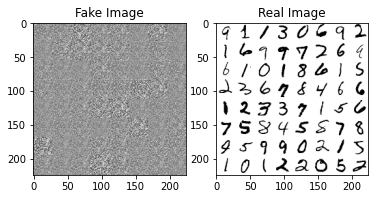

Epoch [1/100] \ Loss D: 0.4100, Recon Loss (BCE): 0.3631
Discriminator Accuracy = 94.24333333333334


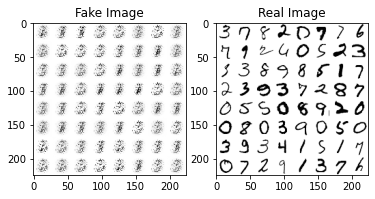

Epoch [2/100] \ Loss D: 0.3838, Recon Loss (BCE): 0.3219
Discriminator Accuracy = 95.64666666666668


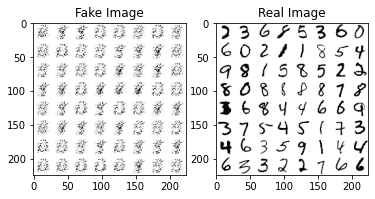

Epoch [3/100] \ Loss D: 0.2792, Recon Loss (BCE): 0.3249
Discriminator Accuracy = 96.83500000000001


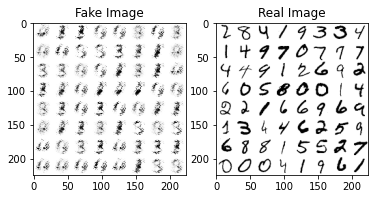

Epoch [4/100] \ Loss D: 0.3145, Recon Loss (BCE): 0.3240
Discriminator Accuracy = 93.80166666666668


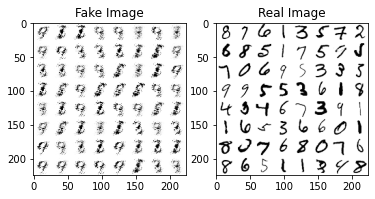

Epoch [5/100] \ Loss D: 0.2321, Recon Loss (BCE): 0.3767
Discriminator Accuracy = 95.55083333333333


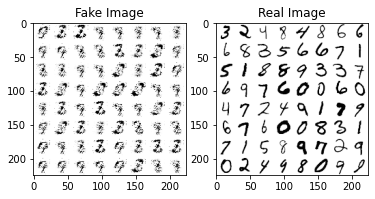

Epoch [6/100] \ Loss D: 0.1663, Recon Loss (BCE): 0.4378
Discriminator Accuracy = 97.2225


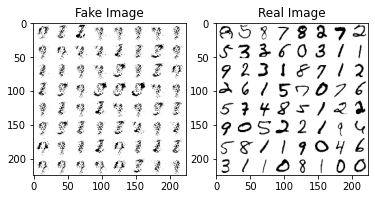

Epoch [7/100] \ Loss D: 0.1609, Recon Loss (BCE): 0.4941
Discriminator Accuracy = 97.19833333333334


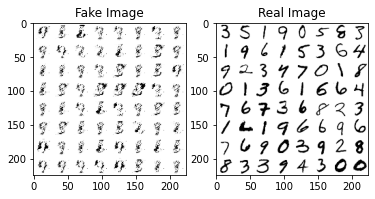

Epoch [8/100] \ Loss D: 0.1514, Recon Loss (BCE): 0.5392
Discriminator Accuracy = 97.03


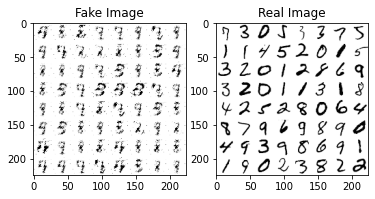

Epoch [9/100] \ Loss D: 0.1241, Recon Loss (BCE): 0.5822
Discriminator Accuracy = 97.205


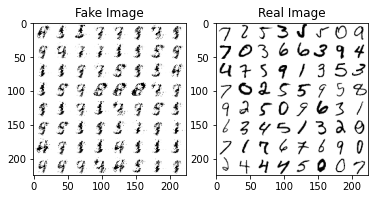

Epoch [10/100] \ Loss D: 0.1194, Recon Loss (BCE): 0.6370
Discriminator Accuracy = 97.0475


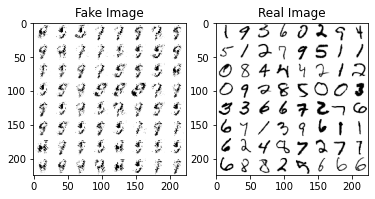

Epoch [11/100] \ Loss D: 0.0885, Recon Loss (BCE): 0.6717
Discriminator Accuracy = 98.0475


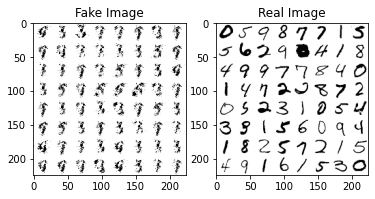

Epoch [12/100] \ Loss D: 0.0985, Recon Loss (BCE): 0.6720
Discriminator Accuracy = 97.78083333333333


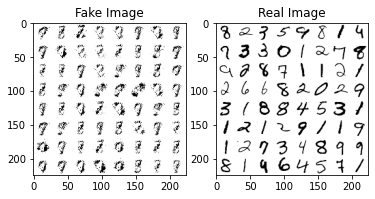

Epoch [13/100] \ Loss D: 0.0836, Recon Loss (BCE): 0.7007
Discriminator Accuracy = 98.47749999999999


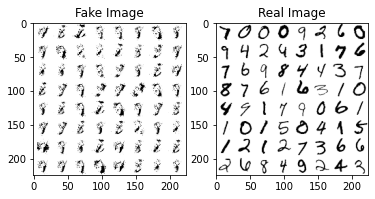

Epoch [14/100] \ Loss D: 0.0769, Recon Loss (BCE): 0.7433
Discriminator Accuracy = 98.35583333333334


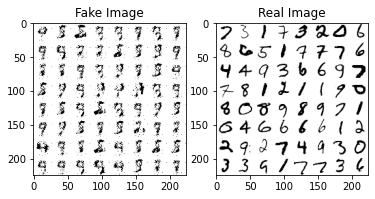

Epoch [15/100] \ Loss D: 0.0719, Recon Loss (BCE): 0.7678
Discriminator Accuracy = 98.44333333333334


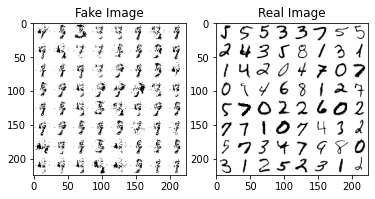

Epoch [16/100] \ Loss D: 0.0598, Recon Loss (BCE): 0.8490
Discriminator Accuracy = 98.76916666666666


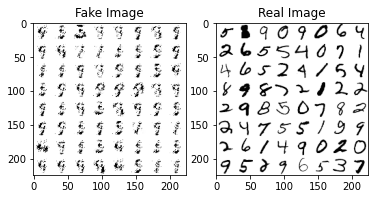

Epoch [17/100] \ Loss D: 0.0562, Recon Loss (BCE): 0.8362
Discriminator Accuracy = 98.76833333333333


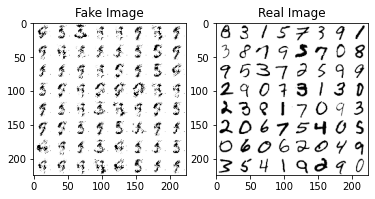

Epoch [18/100] \ Loss D: 0.0550, Recon Loss (BCE): 0.8687
Discriminator Accuracy = 98.77749999999999


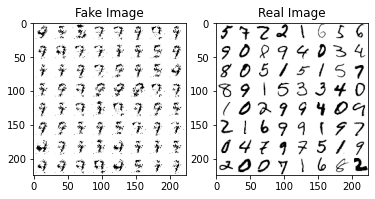

Epoch [19/100] \ Loss D: 0.0540, Recon Loss (BCE): 0.9111
Discriminator Accuracy = 98.7675


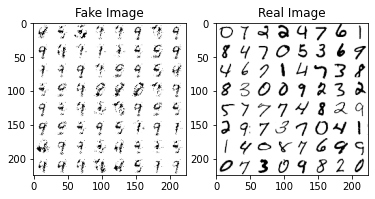

Epoch [20/100] \ Loss D: 0.0611, Recon Loss (BCE): 0.9329
Discriminator Accuracy = 98.50083333333333


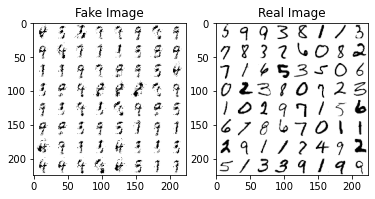

Epoch [21/100] \ Loss D: 0.0549, Recon Loss (BCE): 1.0046
Discriminator Accuracy = 98.6275


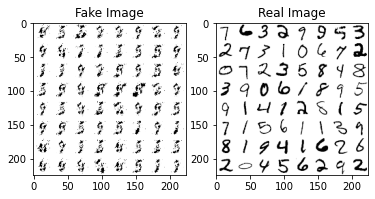

Epoch [22/100] \ Loss D: 0.0347, Recon Loss (BCE): 1.0344
Discriminator Accuracy = 99.19583333333334


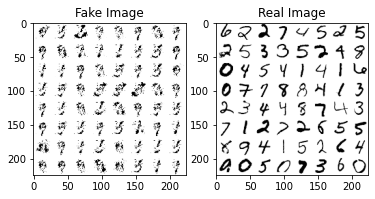

Epoch [23/100] \ Loss D: 0.0330, Recon Loss (BCE): 1.0435
Discriminator Accuracy = 99.2775


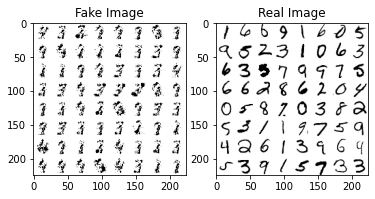

Epoch [24/100] \ Loss D: 0.0368, Recon Loss (BCE): 1.0297
Discriminator Accuracy = 99.16916666666667


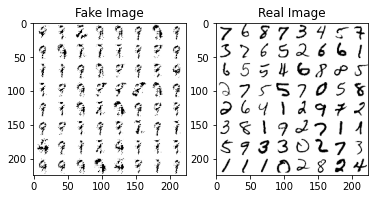

Epoch [25/100] \ Loss D: 0.0407, Recon Loss (BCE): 1.0770
Discriminator Accuracy = 99.04333333333334


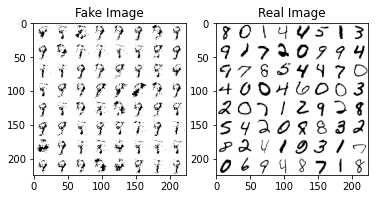

Epoch [26/100] \ Loss D: 0.0434, Recon Loss (BCE): 1.0442
Discriminator Accuracy = 98.98916666666666


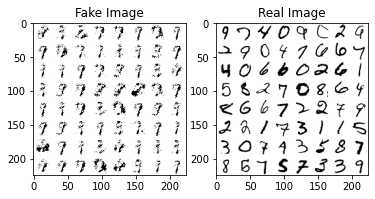

Epoch [27/100] \ Loss D: 0.0337, Recon Loss (BCE): 1.1505
Discriminator Accuracy = 99.19333333333333


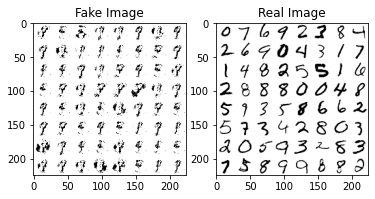

Epoch [28/100] \ Loss D: 0.0369, Recon Loss (BCE): 1.1551
Discriminator Accuracy = 99.11999999999999


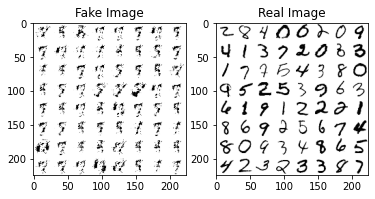

Epoch [29/100] \ Loss D: 0.0243, Recon Loss (BCE): 1.2750
Discriminator Accuracy = 99.44416666666666


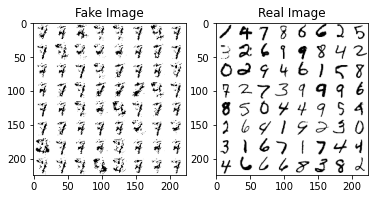

Epoch [30/100] \ Loss D: 0.0281, Recon Loss (BCE): 1.2034
Discriminator Accuracy = 99.3


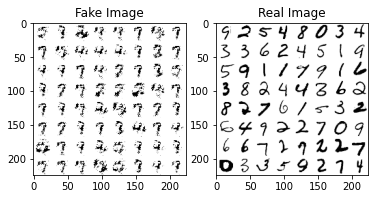

Epoch [31/100] \ Loss D: 0.0200, Recon Loss (BCE): 1.2878
Discriminator Accuracy = 99.54166666666666


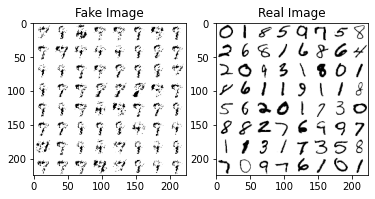

Epoch [32/100] \ Loss D: 0.0224, Recon Loss (BCE): 1.3522
Discriminator Accuracy = 99.46583333333334


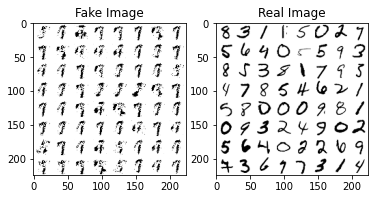

Epoch [33/100] \ Loss D: 0.0230, Recon Loss (BCE): 1.4104
Discriminator Accuracy = 99.46833333333333


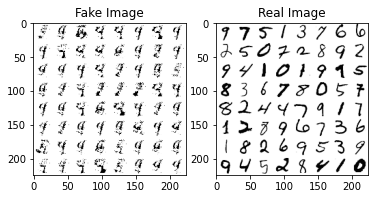

Epoch [34/100] \ Loss D: 0.0172, Recon Loss (BCE): 1.3954
Discriminator Accuracy = 99.59416666666667


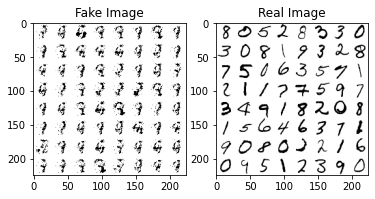

Epoch [35/100] \ Loss D: 0.0192, Recon Loss (BCE): 1.3564
Discriminator Accuracy = 99.53


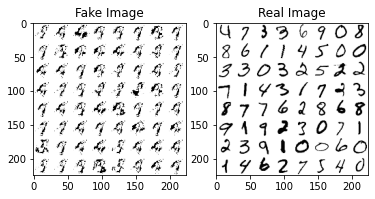

Epoch [36/100] \ Loss D: 0.0153, Recon Loss (BCE): 1.3632
Discriminator Accuracy = 99.65


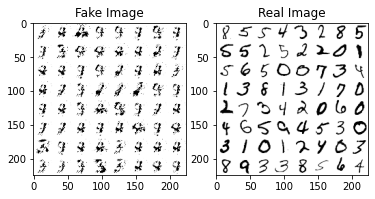

Epoch [37/100] \ Loss D: 0.0185, Recon Loss (BCE): 1.3406
Discriminator Accuracy = 99.53916666666667


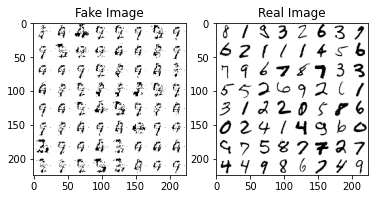

Epoch [38/100] \ Loss D: 0.0155, Recon Loss (BCE): 1.4533
Discriminator Accuracy = 99.64416666666666


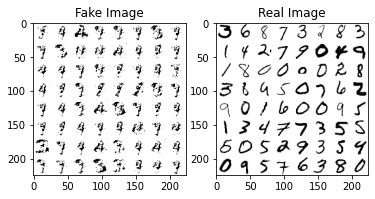

Epoch [39/100] \ Loss D: 0.0227, Recon Loss (BCE): 1.4577
Discriminator Accuracy = 99.44916666666667


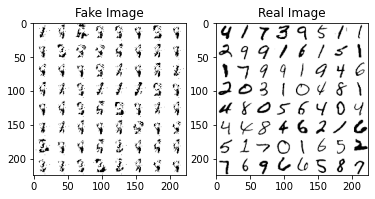

Epoch [40/100] \ Loss D: 0.0189, Recon Loss (BCE): 1.5665
Discriminator Accuracy = 99.5775


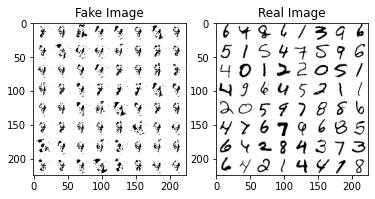

Epoch [41/100] \ Loss D: 0.0207, Recon Loss (BCE): 1.6254
Discriminator Accuracy = 99.495


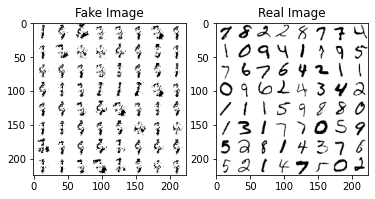

Epoch [42/100] \ Loss D: 0.0282, Recon Loss (BCE): 1.4753
Discriminator Accuracy = 99.27666666666667


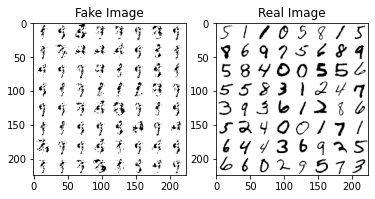

Epoch [43/100] \ Loss D: 0.0218, Recon Loss (BCE): 1.6313
Discriminator Accuracy = 99.45916666666666


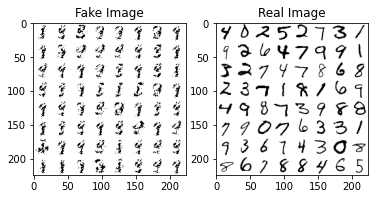

Epoch [44/100] \ Loss D: 0.0225, Recon Loss (BCE): 1.7306
Discriminator Accuracy = 99.47416666666666


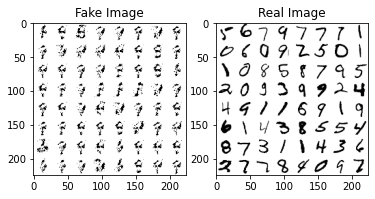

Epoch [45/100] \ Loss D: 0.0228, Recon Loss (BCE): 1.6974
Discriminator Accuracy = 99.425


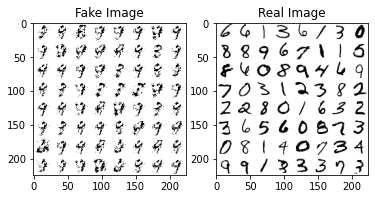

Epoch [46/100] \ Loss D: 0.0161, Recon Loss (BCE): 1.6437
Discriminator Accuracy = 99.63666666666666


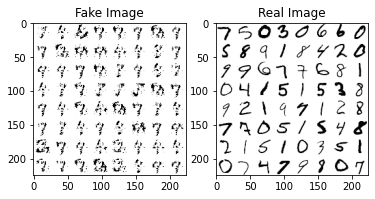

Epoch [47/100] \ Loss D: 0.0173, Recon Loss (BCE): 1.6159
Discriminator Accuracy = 99.60416666666667


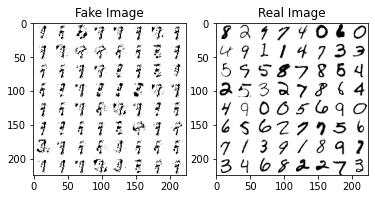

Epoch [48/100] \ Loss D: 0.0194, Recon Loss (BCE): 1.8188
Discriminator Accuracy = 99.52666666666666


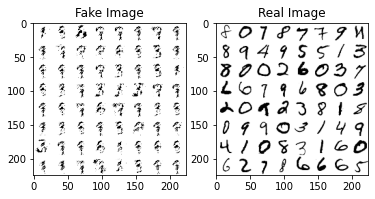

Epoch [49/100] \ Loss D: 0.0166, Recon Loss (BCE): 1.7621
Discriminator Accuracy = 99.595


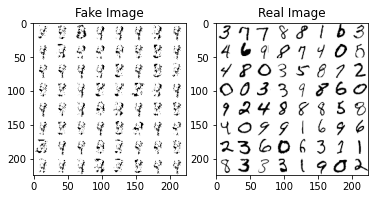

Epoch [50/100] \ Loss D: 0.0121, Recon Loss (BCE): 1.9256
Discriminator Accuracy = 99.7175


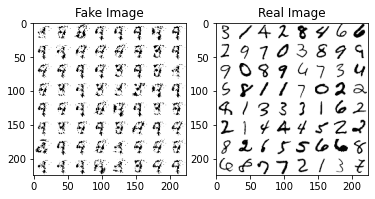

Epoch [51/100] \ Loss D: 0.0128, Recon Loss (BCE): 1.9504
Discriminator Accuracy = 99.65583333333333


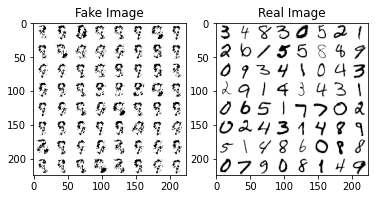

Epoch [52/100] \ Loss D: 0.0170, Recon Loss (BCE): 1.6621
Discriminator Accuracy = 99.6025


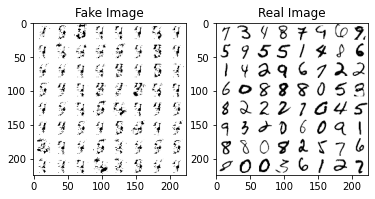

Epoch [53/100] \ Loss D: 0.0137, Recon Loss (BCE): 1.5969
Discriminator Accuracy = 99.67916666666666


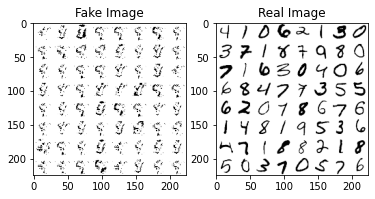

Epoch [54/100] \ Loss D: 0.0114, Recon Loss (BCE): 1.7420
Discriminator Accuracy = 99.7275


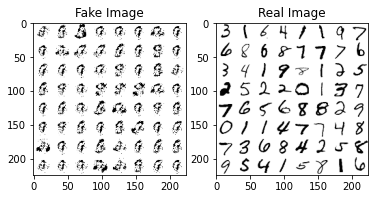

Epoch [55/100] \ Loss D: 0.0127, Recon Loss (BCE): 1.6020
Discriminator Accuracy = 99.68583333333333


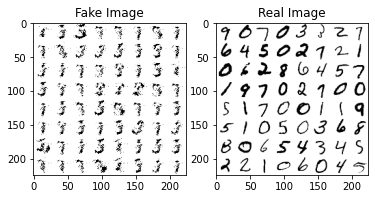

Epoch [56/100] \ Loss D: 0.0137, Recon Loss (BCE): 1.5061
Discriminator Accuracy = 99.68249999999999


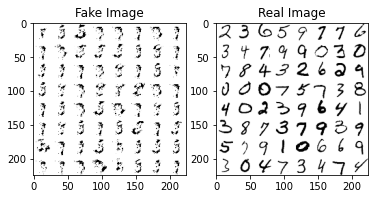

Epoch [57/100] \ Loss D: 0.0167, Recon Loss (BCE): 1.6124
Discriminator Accuracy = 99.605


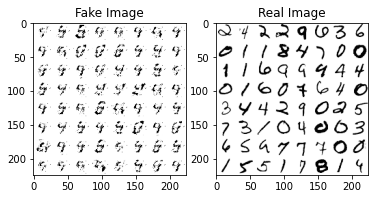

Epoch [58/100] \ Loss D: 0.0154, Recon Loss (BCE): 1.7099
Discriminator Accuracy = 99.63333333333333


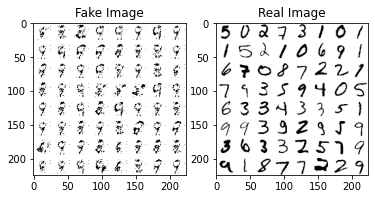

Epoch [59/100] \ Loss D: 0.0137, Recon Loss (BCE): 1.7255
Discriminator Accuracy = 99.655


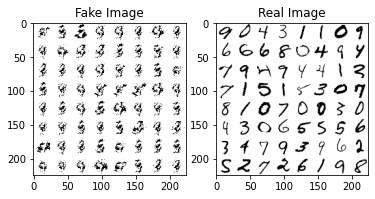

Epoch [60/100] \ Loss D: 0.0131, Recon Loss (BCE): 1.7438
Discriminator Accuracy = 99.66416666666666


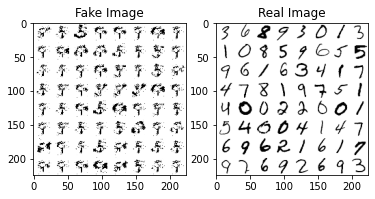

Epoch [61/100] \ Loss D: 0.0103, Recon Loss (BCE): 1.7977
Discriminator Accuracy = 99.75916666666666


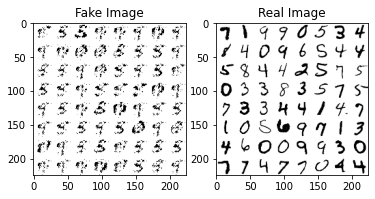

Epoch [62/100] \ Loss D: 0.0076, Recon Loss (BCE): 1.7853
Discriminator Accuracy = 99.81333333333333


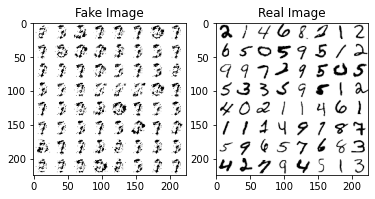

Epoch [63/100] \ Loss D: 0.0148, Recon Loss (BCE): 1.7041
Discriminator Accuracy = 99.63333333333333


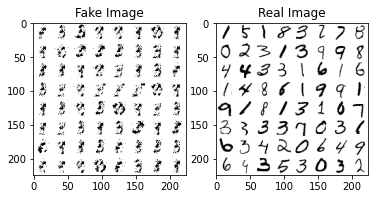

Epoch [64/100] \ Loss D: 0.0167, Recon Loss (BCE): 1.6696
Discriminator Accuracy = 99.59583333333333


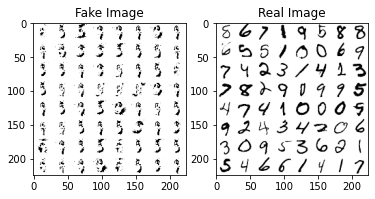

Epoch [65/100] \ Loss D: 0.0181, Recon Loss (BCE): 1.7896
Discriminator Accuracy = 99.57166666666667


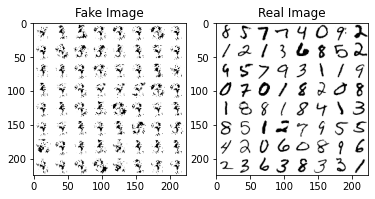

Epoch [66/100] \ Loss D: 0.0131, Recon Loss (BCE): 1.9427
Discriminator Accuracy = 99.66666666666667


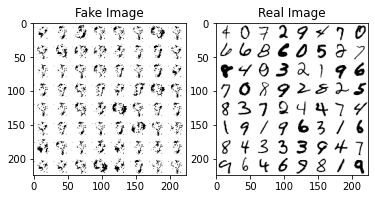

Epoch [67/100] \ Loss D: 0.0101, Recon Loss (BCE): 1.8701
Discriminator Accuracy = 99.74166666666666


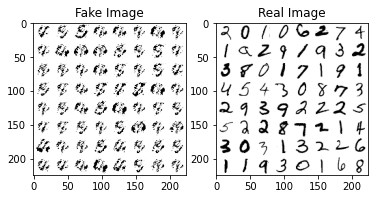

Epoch [68/100] \ Loss D: 0.0097, Recon Loss (BCE): 1.8019
Discriminator Accuracy = 99.74583333333334


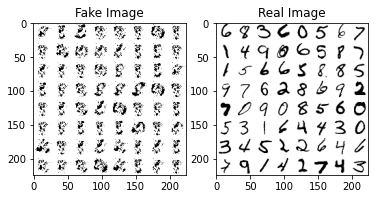

Epoch [69/100] \ Loss D: 0.0115, Recon Loss (BCE): 1.6053
Discriminator Accuracy = 99.7375


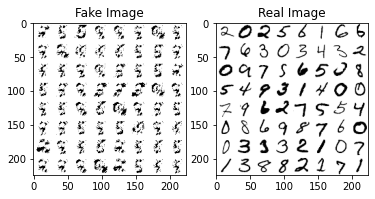

Epoch [70/100] \ Loss D: 0.0093, Recon Loss (BCE): 1.7135
Discriminator Accuracy = 99.78


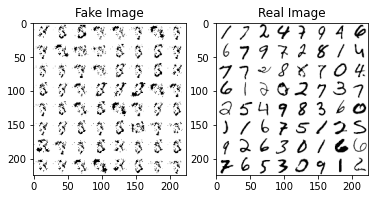

Epoch [71/100] \ Loss D: 0.0088, Recon Loss (BCE): 1.7140
Discriminator Accuracy = 99.785


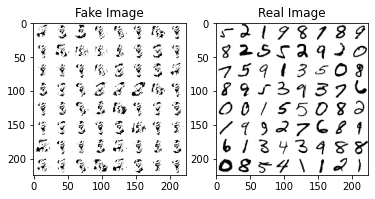

Epoch [72/100] \ Loss D: 0.0094, Recon Loss (BCE): 1.8665
Discriminator Accuracy = 99.76833333333333


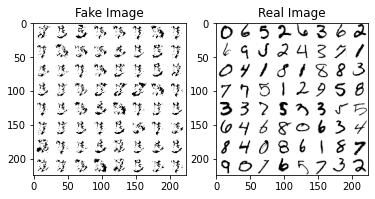

Epoch [73/100] \ Loss D: 0.0061, Recon Loss (BCE): 1.8702
Discriminator Accuracy = 99.85333333333334


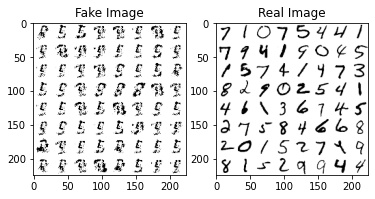

Epoch [74/100] \ Loss D: 0.0081, Recon Loss (BCE): 1.7956
Discriminator Accuracy = 99.81166666666667


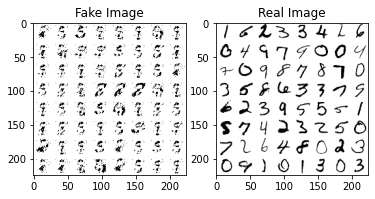

Epoch [75/100] \ Loss D: 0.0107, Recon Loss (BCE): 1.6114
Discriminator Accuracy = 99.75166666666667


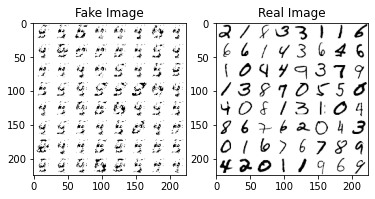

Epoch [76/100] \ Loss D: 0.0094, Recon Loss (BCE): 1.6563
Discriminator Accuracy = 99.775


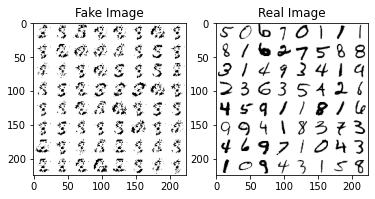

Epoch [77/100] \ Loss D: 0.0082, Recon Loss (BCE): 1.7130
Discriminator Accuracy = 99.815


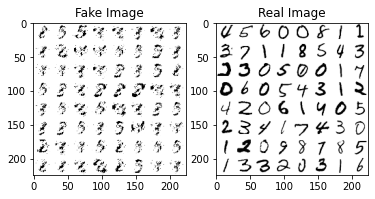

Epoch [78/100] \ Loss D: 0.0119, Recon Loss (BCE): 1.6381
Discriminator Accuracy = 99.70833333333333


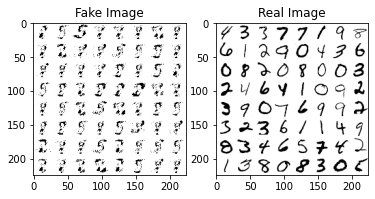

Epoch [79/100] \ Loss D: 0.0105, Recon Loss (BCE): 1.6337
Discriminator Accuracy = 99.7475


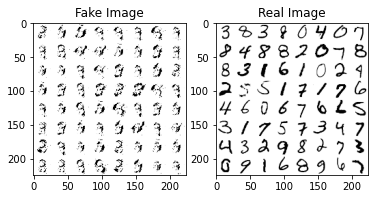

Epoch [80/100] \ Loss D: 0.0114, Recon Loss (BCE): 1.7119
Discriminator Accuracy = 99.73166666666667


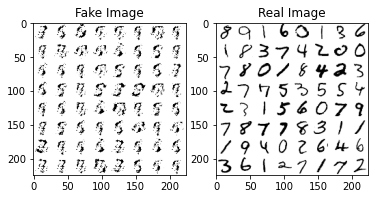

Epoch [81/100] \ Loss D: 0.0105, Recon Loss (BCE): 1.8867
Discriminator Accuracy = 99.74083333333333


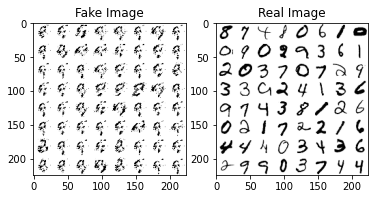

Epoch [82/100] \ Loss D: 0.0097, Recon Loss (BCE): 1.9542
Discriminator Accuracy = 99.75083333333333


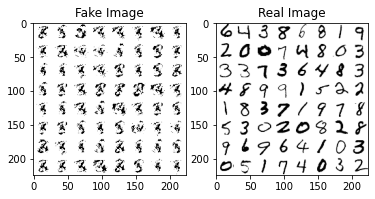

Epoch [83/100] \ Loss D: 0.0127, Recon Loss (BCE): 1.7578
Discriminator Accuracy = 99.68083333333333


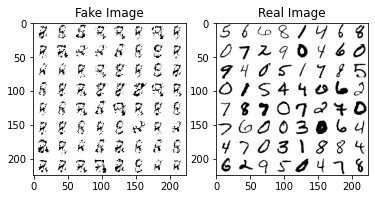

Epoch [84/100] \ Loss D: 0.0136, Recon Loss (BCE): 1.6226
Discriminator Accuracy = 99.67916666666666


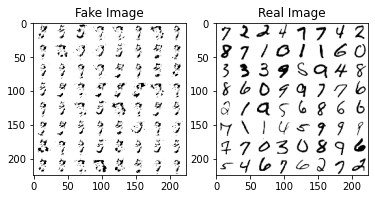

Epoch [85/100] \ Loss D: 0.0128, Recon Loss (BCE): 1.8086
Discriminator Accuracy = 99.68249999999999


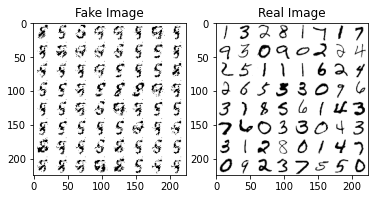

Epoch [86/100] \ Loss D: 0.0122, Recon Loss (BCE): 1.7388
Discriminator Accuracy = 99.69666666666667


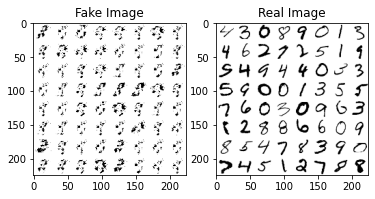

Epoch [87/100] \ Loss D: 0.0182, Recon Loss (BCE): 1.6038
Discriminator Accuracy = 99.57916666666667


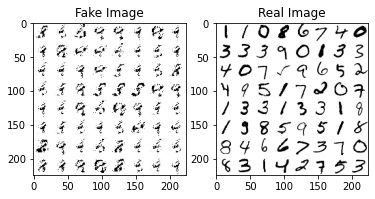

Epoch [88/100] \ Loss D: 0.0147, Recon Loss (BCE): 1.6228
Discriminator Accuracy = 99.61666666666666


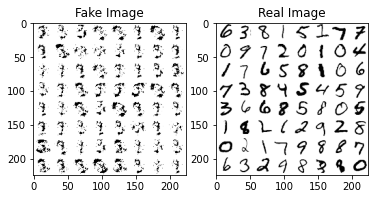

Epoch [89/100] \ Loss D: 0.0125, Recon Loss (BCE): 1.8215
Discriminator Accuracy = 99.69083333333333


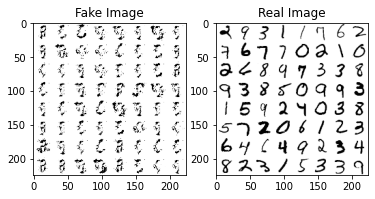

Epoch [90/100] \ Loss D: 0.0171, Recon Loss (BCE): 1.8951
Discriminator Accuracy = 99.57416666666667


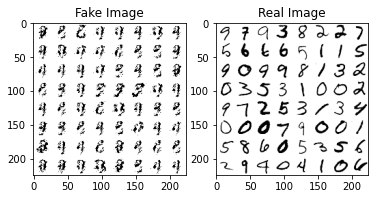

Epoch [91/100] \ Loss D: 0.0156, Recon Loss (BCE): 1.8254
Discriminator Accuracy = 99.61166666666666


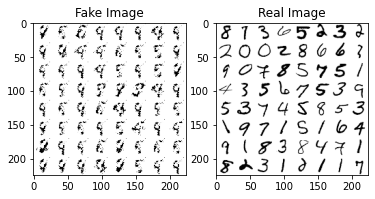

Epoch [92/100] \ Loss D: 0.0110, Recon Loss (BCE): 1.8694
Discriminator Accuracy = 99.73833333333333


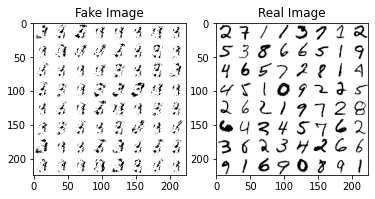

Epoch [93/100] \ Loss D: 0.0136, Recon Loss (BCE): 1.7366
Discriminator Accuracy = 99.66916666666667


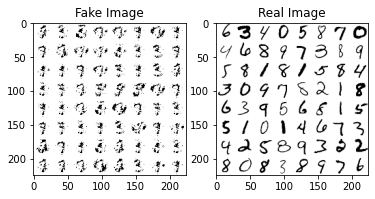

Epoch [94/100] \ Loss D: 0.0138, Recon Loss (BCE): 1.7473
Discriminator Accuracy = 99.6675


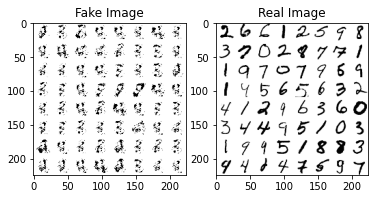

Epoch [95/100] \ Loss D: 0.0119, Recon Loss (BCE): 1.6936
Discriminator Accuracy = 99.71083333333334


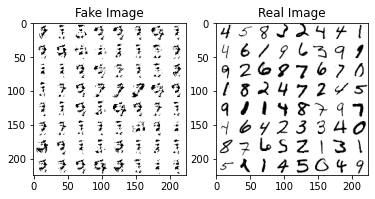

Epoch [96/100] \ Loss D: 0.0129, Recon Loss (BCE): 1.9263
Discriminator Accuracy = 99.66916666666667


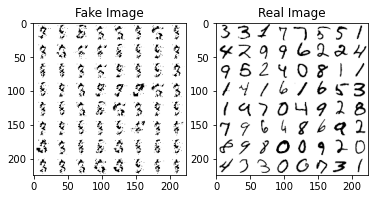

Epoch [97/100] \ Loss D: 0.0135, Recon Loss (BCE): 1.9382
Discriminator Accuracy = 99.65333333333334


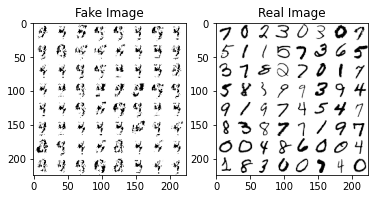

Epoch [98/100] \ Loss D: 0.0149, Recon Loss (BCE): 1.7799
Discriminator Accuracy = 99.62166666666667


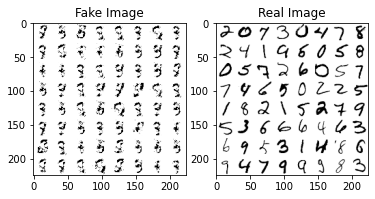

Epoch [99/100] \ Loss D: 0.0203, Recon Loss (BCE): 1.7524
Discriminator Accuracy = 99.50833333333333


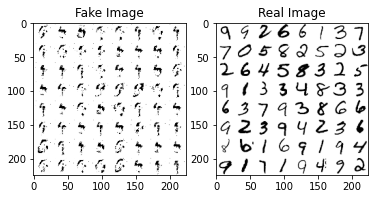

Epoch [100/100] \ Loss D: 0.0225, Recon Loss (BCE): 1.9379
Discriminator Accuracy = 99.42916666666667


In [7]:
disc_BCE = Dicriminator(image_dim).to(device)
en_BCE = Encoder(image_dim,z_dim).to(device)
dc_BCE = Decoder(z_dim,image_dim).to(device)

opt_disc_BCE = optim.Adam(disc_BCE.parameters(),lr=lr_disc)
opt_en_BCE_reg = optim.Adam(en_BCE.parameters(),lr=lr_disc)
opt_en_BCE = optim.Adam(en_BCE.parameters(),lr=lr_gen)
opt_dc_BCE = optim.Adam(dc_BCE.parameters(),lr=lr_gen)

criterion_bce =nn.BCELoss()
BCE_Loss_D = []
BCE_recon_loss = []
BCE_acc = []

for epoch in range(num_epochs):
    lossD_1= 0
    lossDec_1= 0
    lossEn_1 = 0
    Dis_acc = 0
    for batch_idx, (real,_) in enumerate(loader):
        
        real = real.view(-1,784).to(device)
        batch_size = real.shape[0]
        
        noise = torch.randn(batch_size,z_dim).to(device)
        fake = dc_BCE(noise)
        
        disc_real = disc_BCE(real).view(-1)
        disc_fake = disc_BCE(fake).view(-1)
        
        lossD_real = criterion(disc_real,torch.ones_like(disc_real))
        lossD_fake = criterion(disc_fake,torch.zeros_like(disc_fake))
        lossD = (lossD_real+lossD_fake)/2
        lossD_1+=lossD.item()
        
        D_pred_real = (((disc_real) >0.5)*1)
        D_pred_fake = (((disc_fake)>0.5)*1)
        Dis_acc += torch.sum((D_pred_real==torch.ones_like(disc_real))*1).item()
        Dis_acc += torch.sum((D_pred_fake==torch.zeros_like(disc_fake))*1).item()
        
        disc_BCE.zero_grad()
        lossD.backward(retain_graph=True)
        opt_disc_BCE.step()
        
        com = disc_BCE(fake).view(-1)
        lossDec= criterion(com,torch.ones_like(com))
        lossDec_1+=lossDec.item()
        dc_BCE.zero_grad()
        lossDec.backward()
        opt_dc_BCE.step()
        
        
        output = dc_BCE(en_BCE(real))
        lossEn = criterion_bce(output,real)
        lossEn_1+=lossEn.item()
        en_BCE.zero_grad()
        lossEn.backward()
        opt_en_BCE.step()
        
        if batch_idx ==0:
            with torch.no_grad():
                fake = dc_BCE(fixed_noise).reshape(-1,28,28)
                data = real.reshape(-1,28,28)
                img_grid_fake = image_grid(torchvision.utils.make_grid(fake,nrow=batch_size),8).to("cpu")#,normalize=True)
                img_grid_real = image_grid(torchvision.utils.make_grid(data,nrow=batch_size),8).to("cpu")#,normalize=True)
                plt.figure()
                plt.subplot(1,2,1)
                plt.imshow(img_grid_fake,cmap='Greys')
                plt.title("Fake Image")
                plt.subplot(1,2,2)
                plt.imshow(img_grid_real,cmap='Greys')
                plt.title("Real Image")
                plt.show()
                time.sleep(0.01)
        
    lossD_1/=(batch_idx+1)
    loss_g = (lossEn_1)/(batch_idx+1)
    Dis_acc /= 120000
    print(
        f"Epoch [{epoch+1}/{num_epochs}] \ "
        f"Loss D: {lossD_1:.4f}, Recon Loss (BCE): {loss_g:.4f}")
    print(f"Discriminator Accuracy = {Dis_acc*100}")
    BCE_Loss_D.append(lossD_1)
    BCE_recon_loss.append(loss_g)
    BCE_acc.append(Dis_acc*100)

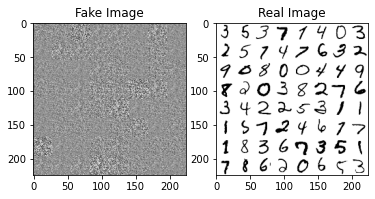

Epoch [1/100] \ Loss D: 0.4164, Recon Loss (SSIM): 0.5604
Discriminator Accuracy = 92.58666666666666


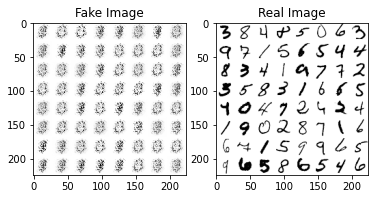

Epoch [2/100] \ Loss D: 0.4213, Recon Loss (SSIM): 0.4676
Discriminator Accuracy = 93.0875


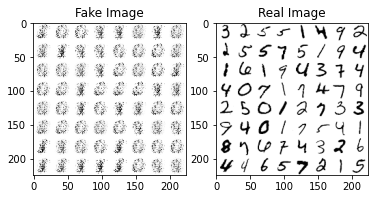

Epoch [3/100] \ Loss D: 0.3282, Recon Loss (SSIM): 0.4733
Discriminator Accuracy = 94.85249999999999


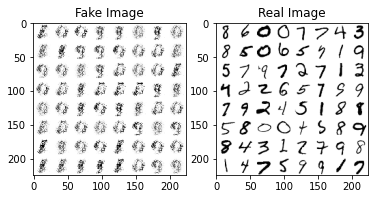

Epoch [4/100] \ Loss D: 0.3036, Recon Loss (SSIM): 0.4415
Discriminator Accuracy = 95.62833333333333


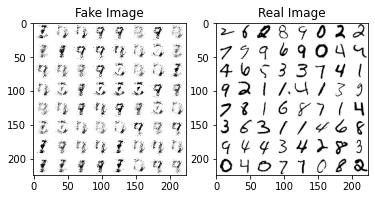

Epoch [5/100] \ Loss D: 0.2515, Recon Loss (SSIM): 0.4437
Discriminator Accuracy = 94.7475


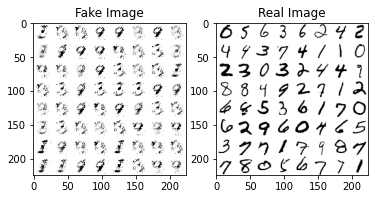

Epoch [6/100] \ Loss D: 0.1874, Recon Loss (SSIM): 0.4604
Discriminator Accuracy = 96.75083333333333


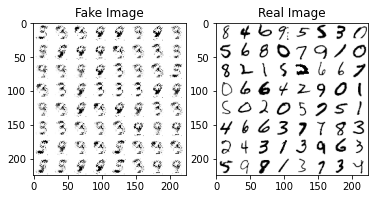

Epoch [7/100] \ Loss D: 0.1587, Recon Loss (SSIM): 0.4695
Discriminator Accuracy = 96.625


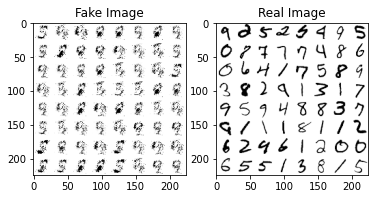

Epoch [8/100] \ Loss D: 0.1396, Recon Loss (SSIM): 0.4820
Discriminator Accuracy = 97.32333333333332


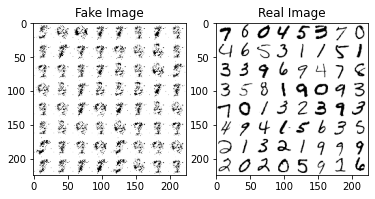

Epoch [9/100] \ Loss D: 0.1245, Recon Loss (SSIM): 0.4755
Discriminator Accuracy = 97.57333333333334


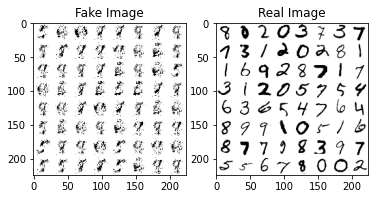

Epoch [10/100] \ Loss D: 0.1030, Recon Loss (SSIM): 0.4778
Discriminator Accuracy = 98.16333333333334


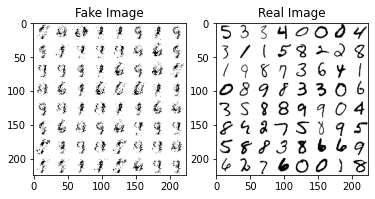

Epoch [11/100] \ Loss D: 0.0986, Recon Loss (SSIM): 0.4534
Discriminator Accuracy = 97.935


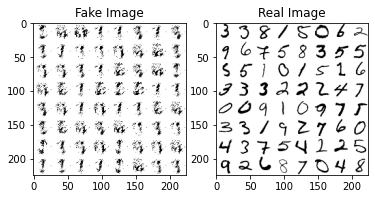

Epoch [12/100] \ Loss D: 0.0915, Recon Loss (SSIM): 0.4381
Discriminator Accuracy = 98.07333333333334


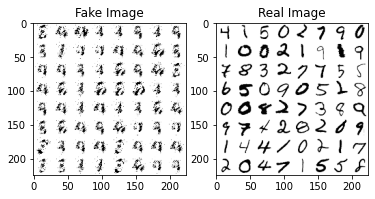

Epoch [13/100] \ Loss D: 0.0704, Recon Loss (SSIM): 0.4423
Discriminator Accuracy = 98.53083333333333


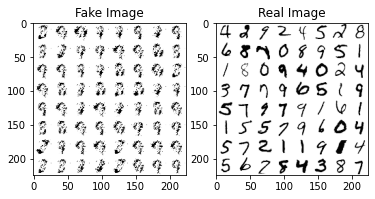

Epoch [14/100] \ Loss D: 0.0568, Recon Loss (SSIM): 0.4429
Discriminator Accuracy = 98.85333333333334


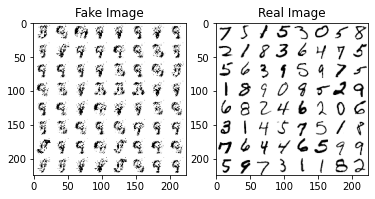

Epoch [15/100] \ Loss D: 0.0439, Recon Loss (SSIM): 0.4510
Discriminator Accuracy = 99.11666666666666


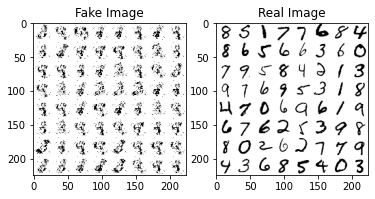

Epoch [16/100] \ Loss D: 0.0326, Recon Loss (SSIM): 0.4594
Discriminator Accuracy = 99.465


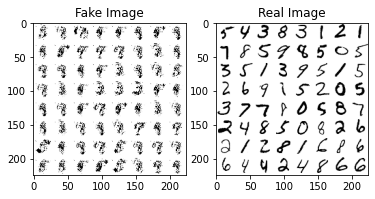

Epoch [17/100] \ Loss D: 0.0326, Recon Loss (SSIM): 0.4369
Discriminator Accuracy = 99.4425


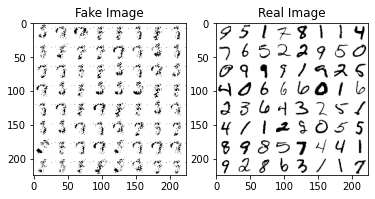

Epoch [18/100] \ Loss D: 0.0301, Recon Loss (SSIM): 0.4361
Discriminator Accuracy = 99.40166666666667


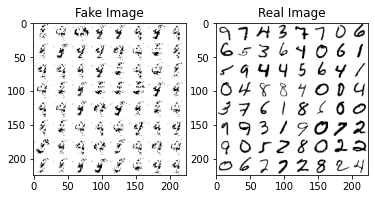

Epoch [19/100] \ Loss D: 0.0311, Recon Loss (SSIM): 0.4318
Discriminator Accuracy = 99.29249999999999


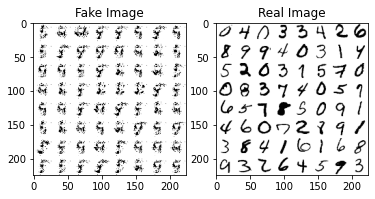

Epoch [20/100] \ Loss D: 0.0263, Recon Loss (SSIM): 0.4404
Discriminator Accuracy = 99.44


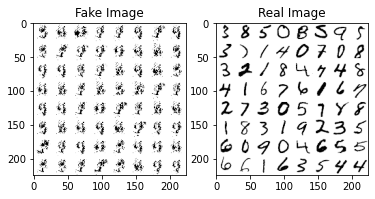

Epoch [21/100] \ Loss D: 0.0230, Recon Loss (SSIM): 0.4285
Discriminator Accuracy = 99.555


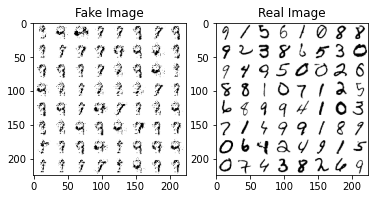

Epoch [22/100] \ Loss D: 0.0269, Recon Loss (SSIM): 0.4180
Discriminator Accuracy = 99.38749999999999


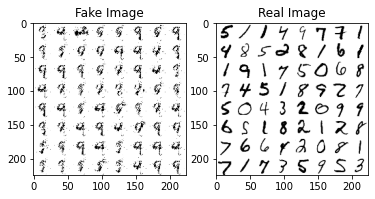

Epoch [23/100] \ Loss D: 0.0323, Recon Loss (SSIM): 0.4194
Discriminator Accuracy = 99.22916666666667


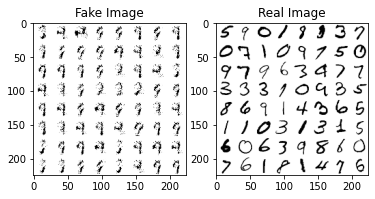

Epoch [24/100] \ Loss D: 0.0287, Recon Loss (SSIM): 0.4227
Discriminator Accuracy = 99.32333333333332


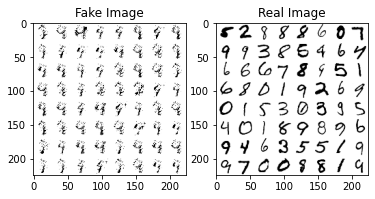

Epoch [25/100] \ Loss D: 0.0248, Recon Loss (SSIM): 0.4256
Discriminator Accuracy = 99.40666666666667


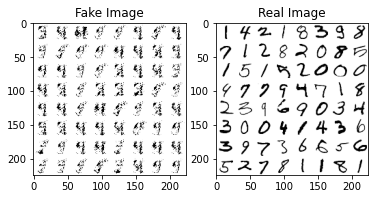

Epoch [26/100] \ Loss D: 0.0286, Recon Loss (SSIM): 0.4403
Discriminator Accuracy = 99.28416666666666


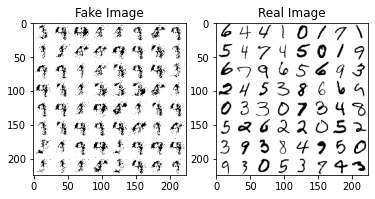

Epoch [27/100] \ Loss D: 0.0307, Recon Loss (SSIM): 0.4355
Discriminator Accuracy = 99.27916666666667


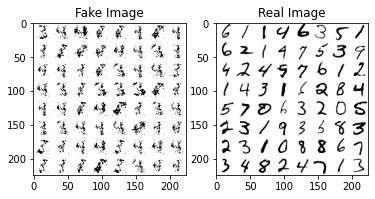

Epoch [28/100] \ Loss D: 0.0248, Recon Loss (SSIM): 0.4414
Discriminator Accuracy = 99.40416666666667


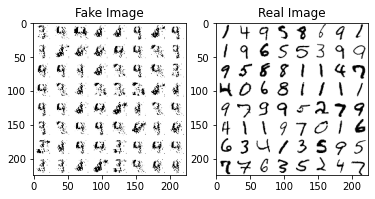

Epoch [29/100] \ Loss D: 0.0268, Recon Loss (SSIM): 0.4396
Discriminator Accuracy = 99.38916666666667


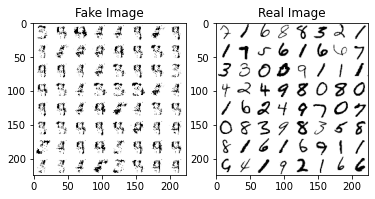

Epoch [30/100] \ Loss D: 0.0264, Recon Loss (SSIM): 0.4311
Discriminator Accuracy = 99.34833333333334


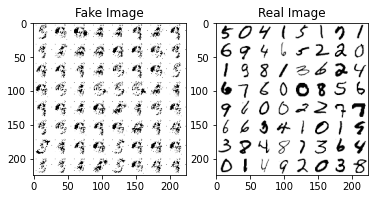

Epoch [31/100] \ Loss D: 0.0226, Recon Loss (SSIM): 0.4415
Discriminator Accuracy = 99.47333333333333


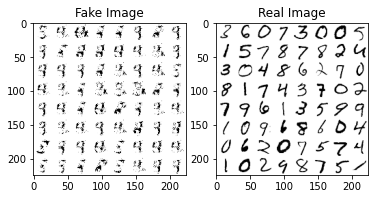

Epoch [32/100] \ Loss D: 0.0225, Recon Loss (SSIM): 0.4194
Discriminator Accuracy = 99.48333333333333


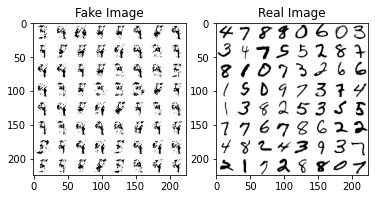

Epoch [33/100] \ Loss D: 0.0220, Recon Loss (SSIM): 0.4313
Discriminator Accuracy = 99.4475


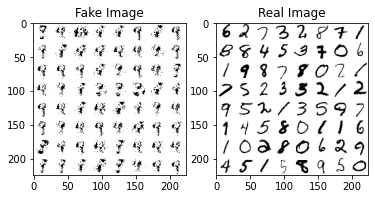

Epoch [34/100] \ Loss D: 0.0224, Recon Loss (SSIM): 0.4207
Discriminator Accuracy = 99.46583333333334


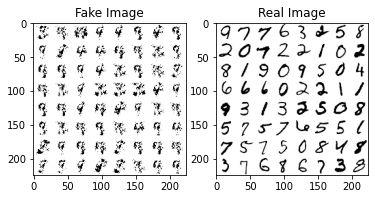

Epoch [35/100] \ Loss D: 0.0196, Recon Loss (SSIM): 0.4207
Discriminator Accuracy = 99.56


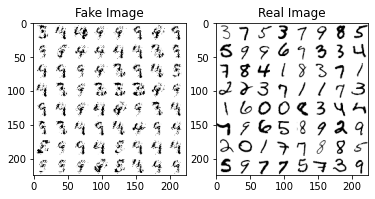

Epoch [36/100] \ Loss D: 0.0209, Recon Loss (SSIM): 0.4114
Discriminator Accuracy = 99.52


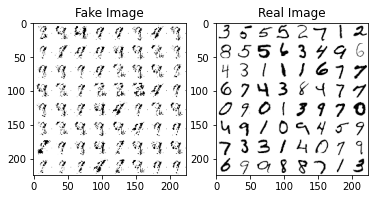

Epoch [37/100] \ Loss D: 0.0233, Recon Loss (SSIM): 0.4229
Discriminator Accuracy = 99.46333333333334


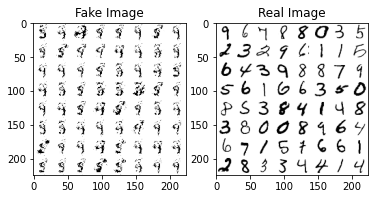

Epoch [38/100] \ Loss D: 0.0225, Recon Loss (SSIM): 0.4254
Discriminator Accuracy = 99.42583333333333


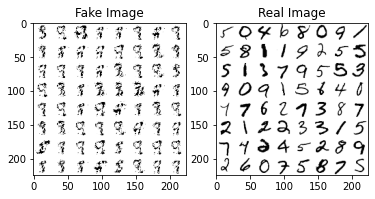

Epoch [39/100] \ Loss D: 0.0240, Recon Loss (SSIM): 0.4231
Discriminator Accuracy = 99.44666666666667


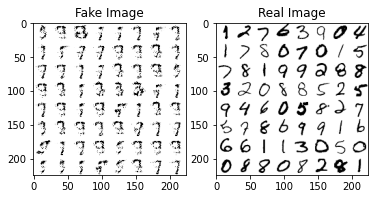

Epoch [40/100] \ Loss D: 0.0228, Recon Loss (SSIM): 0.4202
Discriminator Accuracy = 99.40083333333334


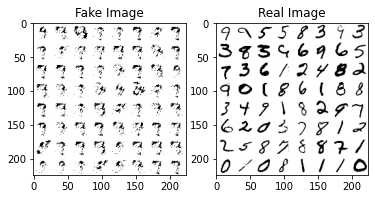

Epoch [41/100] \ Loss D: 0.0178, Recon Loss (SSIM): 0.4390
Discriminator Accuracy = 99.56916666666666


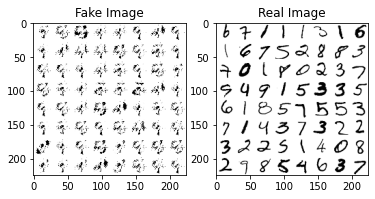

Epoch [42/100] \ Loss D: 0.0179, Recon Loss (SSIM): 0.4415
Discriminator Accuracy = 99.55833333333334


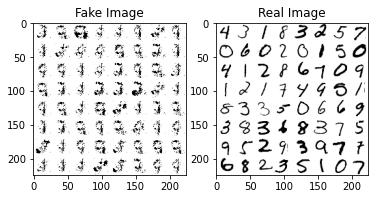

Epoch [43/100] \ Loss D: 0.0154, Recon Loss (SSIM): 0.4326
Discriminator Accuracy = 99.62833333333333


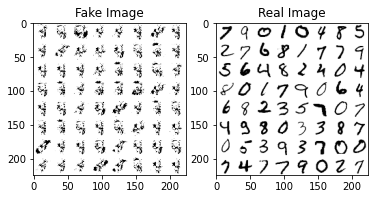

Epoch [44/100] \ Loss D: 0.0146, Recon Loss (SSIM): 0.4229
Discriminator Accuracy = 99.665


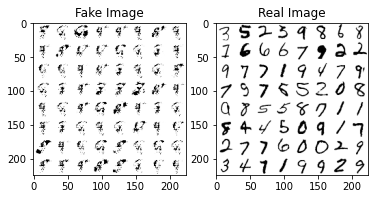

Epoch [45/100] \ Loss D: 0.0172, Recon Loss (SSIM): 0.4336
Discriminator Accuracy = 99.62166666666667


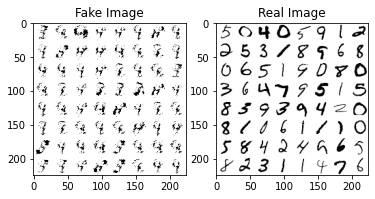

Epoch [46/100] \ Loss D: 0.0200, Recon Loss (SSIM): 0.4169
Discriminator Accuracy = 99.48833333333333


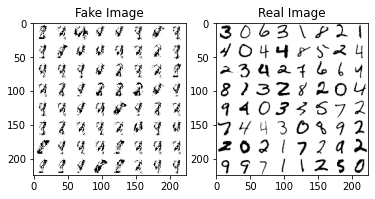

Epoch [47/100] \ Loss D: 0.0255, Recon Loss (SSIM): 0.4128
Discriminator Accuracy = 99.32416666666667


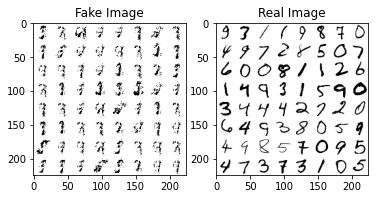

Epoch [48/100] \ Loss D: 0.0250, Recon Loss (SSIM): 0.4155
Discriminator Accuracy = 99.39416666666666


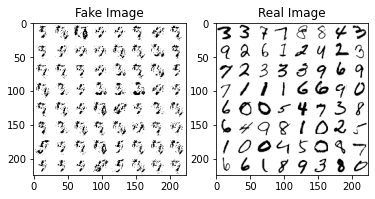

Epoch [49/100] \ Loss D: 0.0215, Recon Loss (SSIM): 0.4290
Discriminator Accuracy = 99.47833333333334


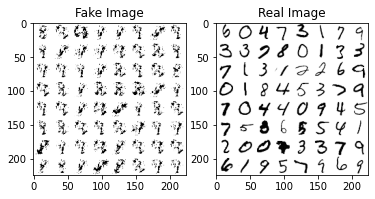

Epoch [50/100] \ Loss D: 0.0188, Recon Loss (SSIM): 0.4341
Discriminator Accuracy = 99.55916666666667


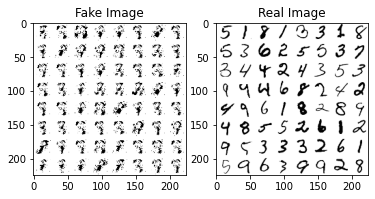

Epoch [51/100] \ Loss D: 0.0154, Recon Loss (SSIM): 0.4301
Discriminator Accuracy = 99.63666666666666


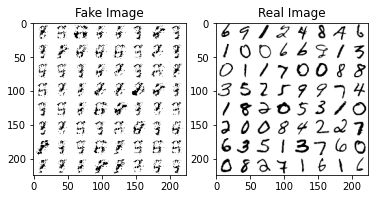

Epoch [52/100] \ Loss D: 0.0185, Recon Loss (SSIM): 0.4206
Discriminator Accuracy = 99.5425


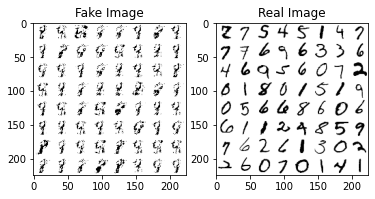

Epoch [53/100] \ Loss D: 0.0173, Recon Loss (SSIM): 0.4218
Discriminator Accuracy = 99.62083333333334


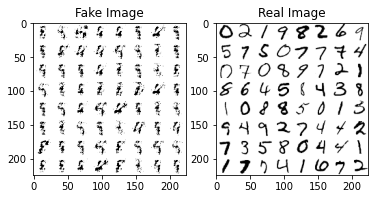

Epoch [54/100] \ Loss D: 0.0234, Recon Loss (SSIM): 0.4061
Discriminator Accuracy = 99.39666666666666


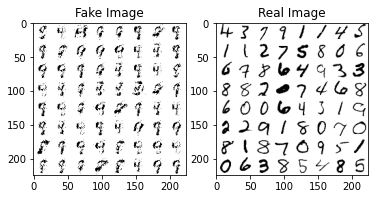

Epoch [55/100] \ Loss D: 0.0192, Recon Loss (SSIM): 0.4093
Discriminator Accuracy = 99.54583333333333


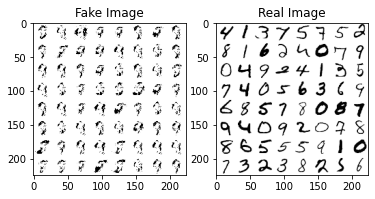

Epoch [56/100] \ Loss D: 0.0194, Recon Loss (SSIM): 0.4198
Discriminator Accuracy = 99.5175


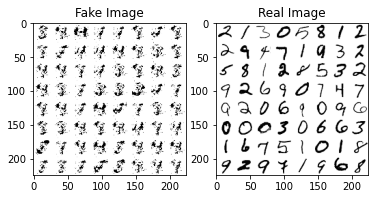

Epoch [57/100] \ Loss D: 0.0160, Recon Loss (SSIM): 0.4310
Discriminator Accuracy = 99.6125


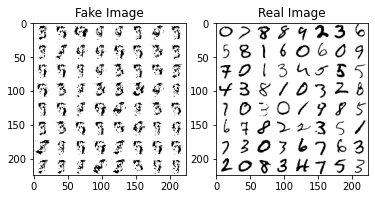

Epoch [58/100] \ Loss D: 0.0171, Recon Loss (SSIM): 0.4244
Discriminator Accuracy = 99.59833333333333


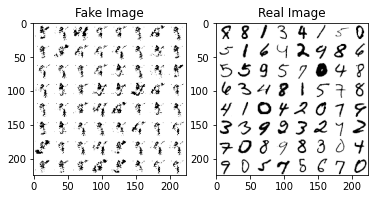

Epoch [59/100] \ Loss D: 0.0155, Recon Loss (SSIM): 0.4176
Discriminator Accuracy = 99.62416666666667


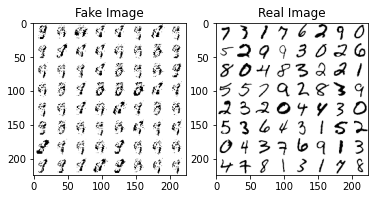

Epoch [60/100] \ Loss D: 0.0125, Recon Loss (SSIM): 0.4200
Discriminator Accuracy = 99.71166666666666


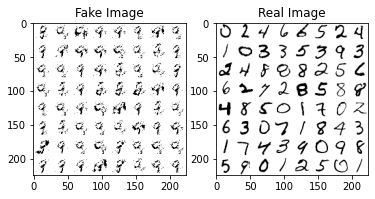

Epoch [61/100] \ Loss D: 0.0136, Recon Loss (SSIM): 0.4197
Discriminator Accuracy = 99.6625


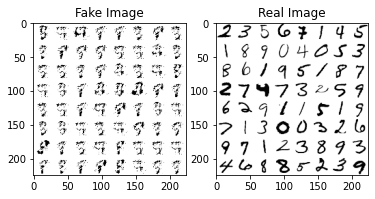

Epoch [62/100] \ Loss D: 0.0106, Recon Loss (SSIM): 0.4215
Discriminator Accuracy = 99.76083333333334


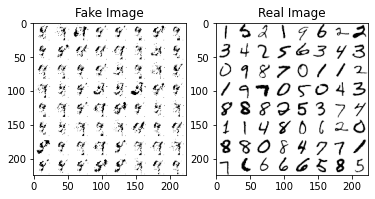

Epoch [63/100] \ Loss D: 0.0163, Recon Loss (SSIM): 0.4211
Discriminator Accuracy = 99.59166666666667


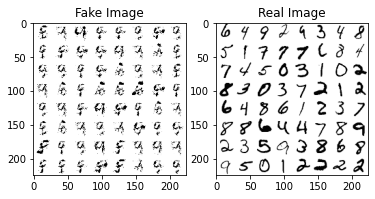

Epoch [64/100] \ Loss D: 0.0152, Recon Loss (SSIM): 0.4122
Discriminator Accuracy = 99.61416666666668


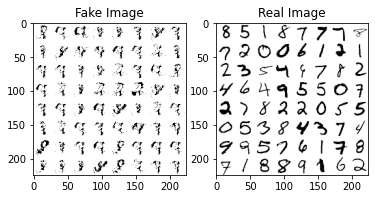

Epoch [65/100] \ Loss D: 0.0155, Recon Loss (SSIM): 0.4065
Discriminator Accuracy = 99.60416666666667


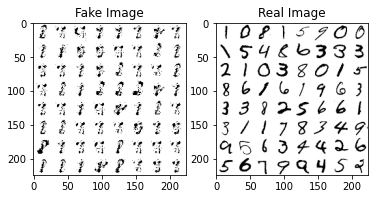

Epoch [66/100] \ Loss D: 0.0159, Recon Loss (SSIM): 0.4182
Discriminator Accuracy = 99.59583333333333


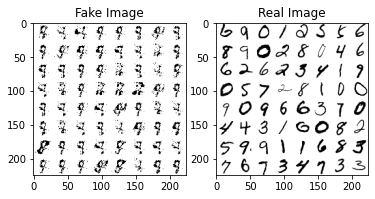

Epoch [67/100] \ Loss D: 0.0142, Recon Loss (SSIM): 0.4183
Discriminator Accuracy = 99.65583333333333


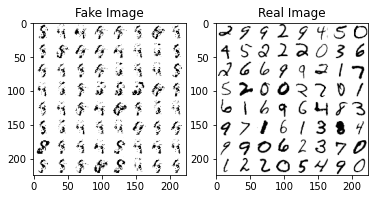

Epoch [68/100] \ Loss D: 0.0196, Recon Loss (SSIM): 0.4086
Discriminator Accuracy = 99.52666666666666


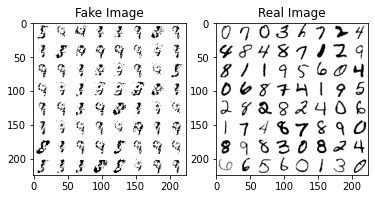

Epoch [69/100] \ Loss D: 0.0172, Recon Loss (SSIM): 0.4148
Discriminator Accuracy = 99.57833333333333


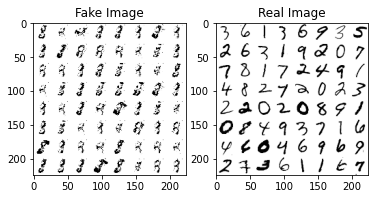

Epoch [70/100] \ Loss D: 0.0150, Recon Loss (SSIM): 0.4209
Discriminator Accuracy = 99.63


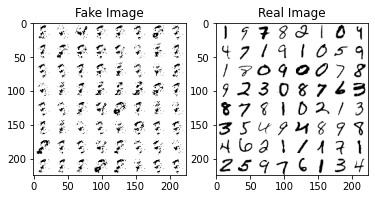

Epoch [71/100] \ Loss D: 0.0141, Recon Loss (SSIM): 0.4246
Discriminator Accuracy = 99.665


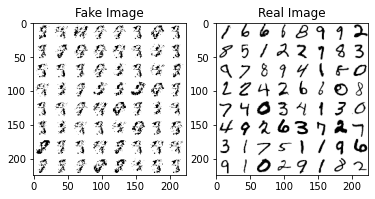

Epoch [72/100] \ Loss D: 0.0127, Recon Loss (SSIM): 0.4279
Discriminator Accuracy = 99.68416666666667


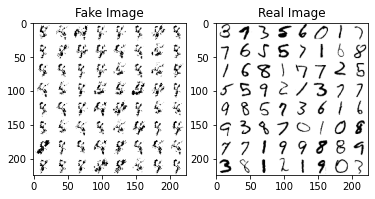

Epoch [73/100] \ Loss D: 0.0151, Recon Loss (SSIM): 0.4246
Discriminator Accuracy = 99.6375


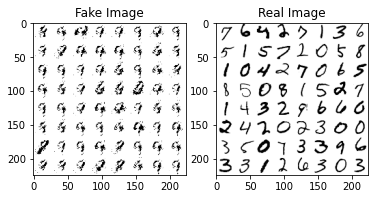

Epoch [74/100] \ Loss D: 0.0159, Recon Loss (SSIM): 0.4125
Discriminator Accuracy = 99.5925


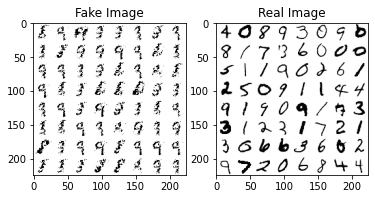

Epoch [75/100] \ Loss D: 0.0189, Recon Loss (SSIM): 0.4126
Discriminator Accuracy = 99.55583333333334


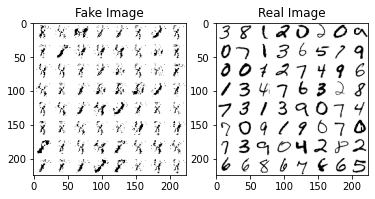

Epoch [76/100] \ Loss D: 0.0203, Recon Loss (SSIM): 0.4079
Discriminator Accuracy = 99.48916666666666


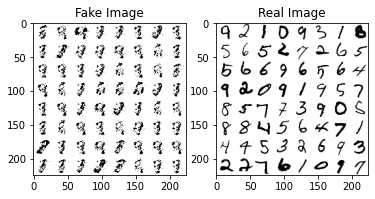

Epoch [77/100] \ Loss D: 0.0125, Recon Loss (SSIM): 0.4136
Discriminator Accuracy = 99.7025


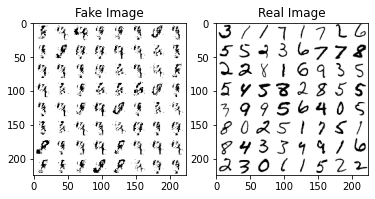

Epoch [78/100] \ Loss D: 0.0129, Recon Loss (SSIM): 0.4146
Discriminator Accuracy = 99.6925


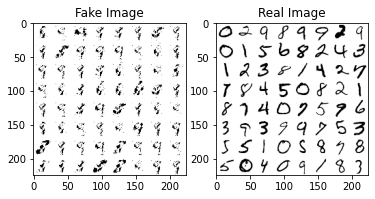

Epoch [79/100] \ Loss D: 0.0131, Recon Loss (SSIM): 0.4123
Discriminator Accuracy = 99.68666666666667


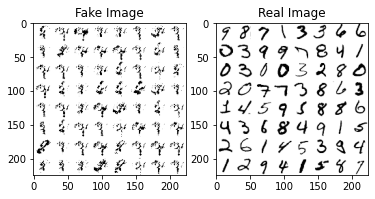

Epoch [80/100] \ Loss D: 0.0142, Recon Loss (SSIM): 0.4241
Discriminator Accuracy = 99.65166666666667


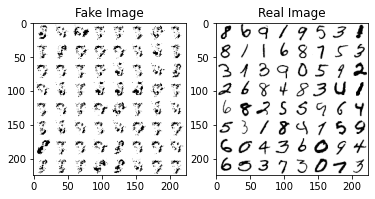

Epoch [81/100] \ Loss D: 0.0161, Recon Loss (SSIM): 0.4177
Discriminator Accuracy = 99.63166666666666


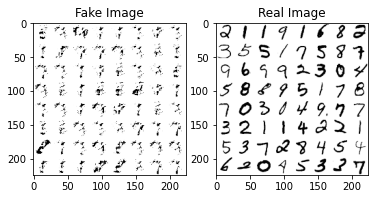

Epoch [82/100] \ Loss D: 0.0143, Recon Loss (SSIM): 0.4241
Discriminator Accuracy = 99.66083333333333


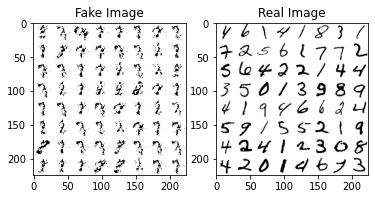

Epoch [83/100] \ Loss D: 0.0196, Recon Loss (SSIM): 0.4085
Discriminator Accuracy = 99.53


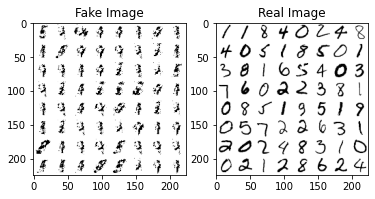

Epoch [84/100] \ Loss D: 0.0194, Recon Loss (SSIM): 0.4130
Discriminator Accuracy = 99.48666666666666


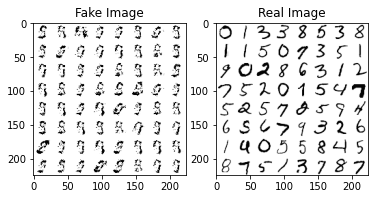

Epoch [85/100] \ Loss D: 0.0151, Recon Loss (SSIM): 0.4204
Discriminator Accuracy = 99.60083333333334


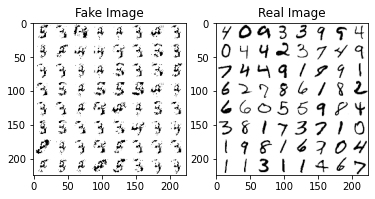

Epoch [86/100] \ Loss D: 0.0181, Recon Loss (SSIM): 0.4254
Discriminator Accuracy = 99.5275


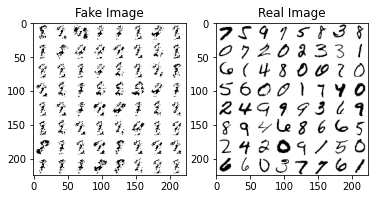

Epoch [87/100] \ Loss D: 0.0161, Recon Loss (SSIM): 0.4185
Discriminator Accuracy = 99.615


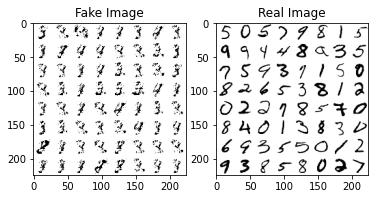

Epoch [88/100] \ Loss D: 0.0202, Recon Loss (SSIM): 0.4093
Discriminator Accuracy = 99.495


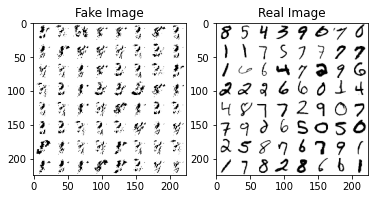

Epoch [89/100] \ Loss D: 0.0163, Recon Loss (SSIM): 0.4121
Discriminator Accuracy = 99.58500000000001


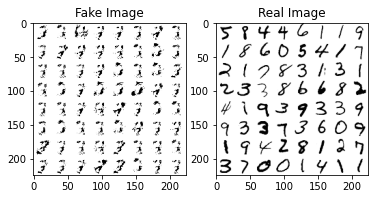

Epoch [90/100] \ Loss D: 0.0150, Recon Loss (SSIM): 0.4167
Discriminator Accuracy = 99.6025


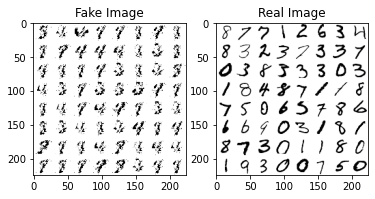

Epoch [91/100] \ Loss D: 0.0161, Recon Loss (SSIM): 0.4160
Discriminator Accuracy = 99.59916666666668


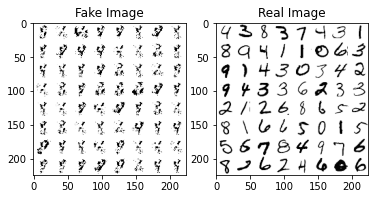

Epoch [92/100] \ Loss D: 0.0186, Recon Loss (SSIM): 0.4071
Discriminator Accuracy = 99.55083333333333


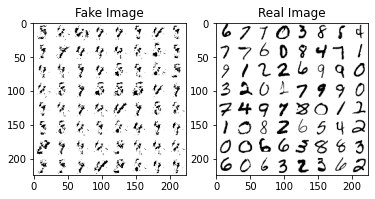

Epoch [93/100] \ Loss D: 0.0209, Recon Loss (SSIM): 0.4042
Discriminator Accuracy = 99.4725


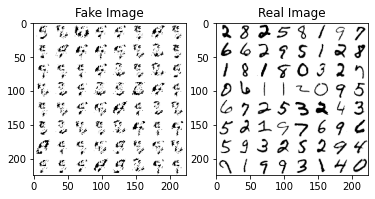

Epoch [94/100] \ Loss D: 0.0182, Recon Loss (SSIM): 0.4145
Discriminator Accuracy = 99.55416666666666


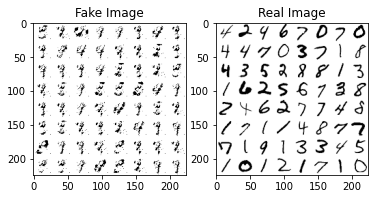

Epoch [95/100] \ Loss D: 0.0174, Recon Loss (SSIM): 0.4122
Discriminator Accuracy = 99.55916666666667


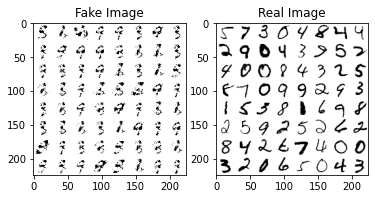

Epoch [96/100] \ Loss D: 0.0184, Recon Loss (SSIM): 0.4141
Discriminator Accuracy = 99.51166666666667


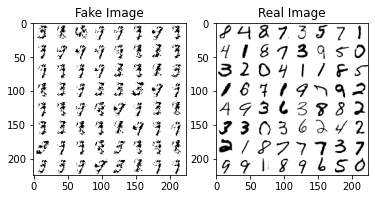

Epoch [97/100] \ Loss D: 0.0228, Recon Loss (SSIM): 0.4078
Discriminator Accuracy = 99.40166666666667


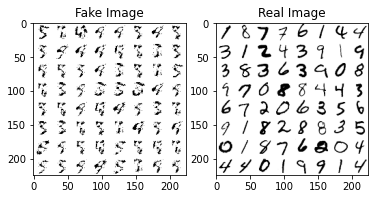

Epoch [98/100] \ Loss D: 0.0185, Recon Loss (SSIM): 0.4180
Discriminator Accuracy = 99.54583333333333


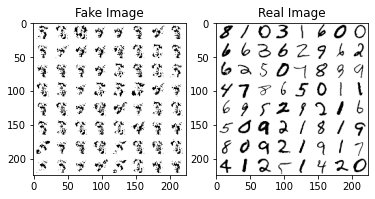

Epoch [99/100] \ Loss D: 0.0142, Recon Loss (SSIM): 0.4289
Discriminator Accuracy = 99.6525


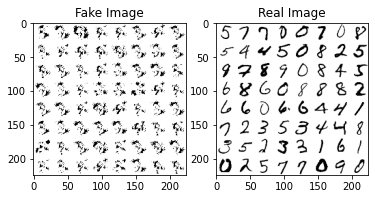

Epoch [100/100] \ Loss D: 0.0089, Recon Loss (SSIM): 0.4558
Discriminator Accuracy = 99.78166666666667


In [8]:
disc_SSIM = Dicriminator(image_dim).to(device)
en_SSIM = Encoder(image_dim,z_dim).to(device)
dc_SSIM = Decoder(z_dim,image_dim).to(device)

opt_disc_SSIM = optim.Adam(disc_SSIM.parameters(),lr=lr_disc)
opt_en_SSIM = optim.Adam(en_SSIM.parameters(),lr=lr_gen)
opt_dc_SSIM = optim.Adam(dc_SSIM.parameters(),lr=lr_gen)

criterion_ssim = SSIM(n_channels=1).to(device)
SSIM_Loss_D = []
SSIM_recon_loss = []
SSIM_acc = []

for epoch in range(num_epochs):
    lossD_1= 0
    lossDec_1= 0
    lossEn_1 = 0
    Dis_acc = 0
    for batch_idx, (real,_) in enumerate(loader):
        
        real = real.view(-1,784).to(device)
        batch_size = real.shape[0]
        
        noise = torch.randn(batch_size,z_dim).to(device)
        fake = dc_SSIM(noise)
        
        disc_real = disc_SSIM(real).view(-1)
        disc_fake = disc_SSIM(fake).view(-1)
        
        lossD_real = criterion(disc_real,torch.ones_like(disc_real))
        lossD_fake = criterion(disc_fake,torch.zeros_like(disc_fake))
        lossD = (lossD_real+lossD_fake)/2
        lossD_1+=lossD.item()
        
        D_pred_real = (((disc_real) >0.5)*1)
        D_pred_fake = (((disc_fake)>0.5)*1)
        Dis_acc += torch.sum((D_pred_real==torch.ones_like(disc_real))*1).item()
        Dis_acc += torch.sum((D_pred_fake==torch.zeros_like(disc_fake))*1).item()
        
        disc_SSIM.zero_grad()
        lossD.backward(retain_graph=True)
        opt_disc_SSIM.step()
        
        com = disc_SSIM(fake).view(-1)
        lossDec= criterion(com,torch.ones_like(com))
        lossDec_1+=lossDec.item()
        dc_SSIM.zero_grad()
        lossDec.backward(retain_graph=True)
        opt_dc_SSIM.step()
        
        output = dc_SSIM(en_SSIM(real))
        lossEn = 1-criterion_ssim(torch.unsqueeze(output, 1), torch.unsqueeze(real, 1))
        lossEn_1+=lossEn.item()
        en_SSIM.zero_grad()
        lossEn.backward()
        opt_en_SSIM.step()
        
        if batch_idx ==0:
            with torch.no_grad():
                fake = dc_SSIM(fixed_noise).reshape(-1,28,28)
                data = real.reshape(-1,28,28)
                img_grid_fake = image_grid(torchvision.utils.make_grid(fake,nrow=batch_size),8).to("cpu")#,normalize=True)
                img_grid_real = image_grid(torchvision.utils.make_grid(data,nrow=batch_size),8).to("cpu")#,normalize=True)
                plt.figure()
                plt.subplot(1,2,1)
                plt.imshow(img_grid_fake,cmap='Greys')
                plt.title("Fake Image")
                plt.subplot(1,2,2)
                plt.imshow(img_grid_real,cmap='Greys')
                plt.title("Real Image")
                plt.show()
                time.sleep(0.01)
        
    lossD_1/=(batch_idx+1)
    loss_g = (lossEn_1)/(batch_idx+1)
    Dis_acc /= 120000
    print(
        f"Epoch [{epoch+1}/{num_epochs}] \ "
        f"Loss D: {lossD_1:.4f}, Recon Loss (SSIM): {loss_g:.4f}")
    print(f"Discriminator Accuracy = {Dis_acc*100}")
    SSIM_Loss_D.append(lossD_1)
    SSIM_recon_loss.append(loss_g)
    SSIM_acc.append(Dis_acc*100)

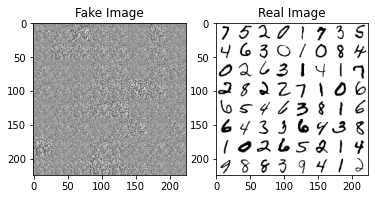

Epoch [1/100] \ Loss D: 0.4123, Recon Loss (MSE): 0.1029
Discriminator Accuracy = 93.82833333333333


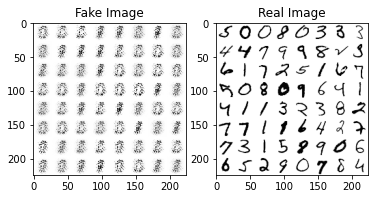

Epoch [2/100] \ Loss D: 0.4403, Recon Loss (MSE): 0.0833
Discriminator Accuracy = 91.45166666666667


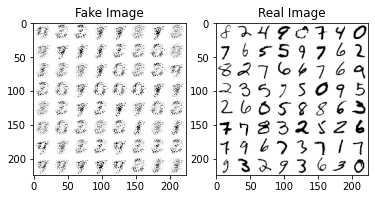

Epoch [3/100] \ Loss D: 0.3174, Recon Loss (MSE): 0.0804
Discriminator Accuracy = 97.32333333333332


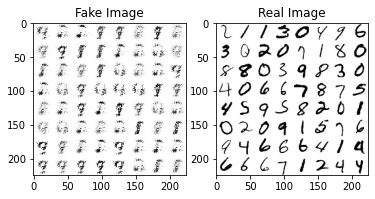

Epoch [4/100] \ Loss D: 0.2834, Recon Loss (MSE): 0.0790
Discriminator Accuracy = 95.1825


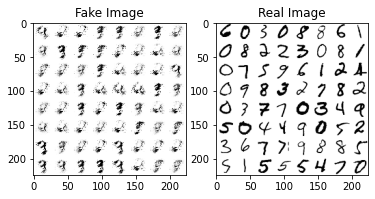

Epoch [5/100] \ Loss D: 0.2556, Recon Loss (MSE): 0.0873
Discriminator Accuracy = 94.35666666666667


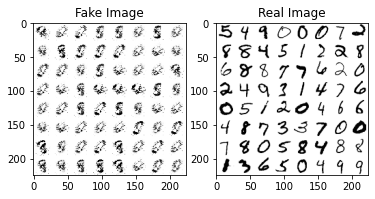

Epoch [6/100] \ Loss D: 0.1661, Recon Loss (MSE): 0.0923
Discriminator Accuracy = 96.79166666666667


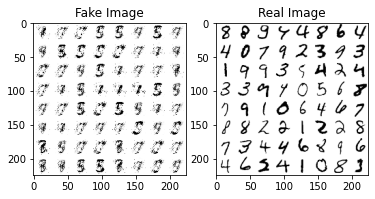

Epoch [7/100] \ Loss D: 0.1361, Recon Loss (MSE): 0.0924
Discriminator Accuracy = 97.46833333333333


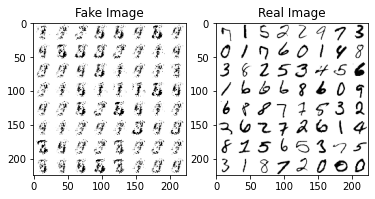

Epoch [8/100] \ Loss D: 0.1052, Recon Loss (MSE): 0.0968
Discriminator Accuracy = 98.18416666666666


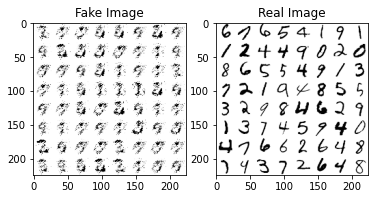

Epoch [9/100] \ Loss D: 0.0953, Recon Loss (MSE): 0.0986
Discriminator Accuracy = 98.4325


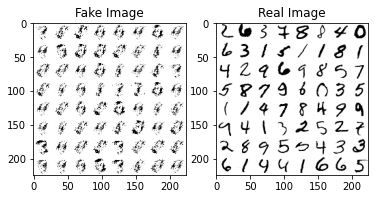

Epoch [10/100] \ Loss D: 0.0895, Recon Loss (MSE): 0.0969
Discriminator Accuracy = 98.57416666666666


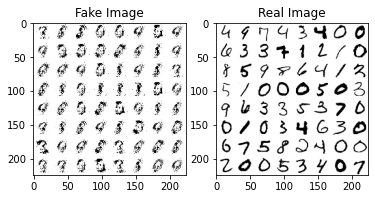

Epoch [11/100] \ Loss D: 0.0847, Recon Loss (MSE): 0.0939
Discriminator Accuracy = 98.41666666666666


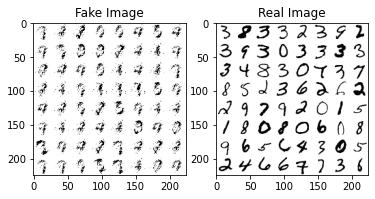

Epoch [12/100] \ Loss D: 0.0663, Recon Loss (MSE): 0.0968
Discriminator Accuracy = 98.64333333333335


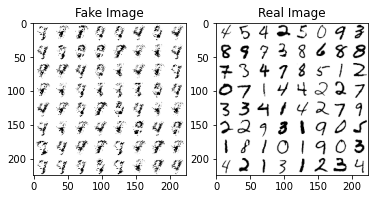

Epoch [13/100] \ Loss D: 0.0501, Recon Loss (MSE): 0.1053
Discriminator Accuracy = 99.0


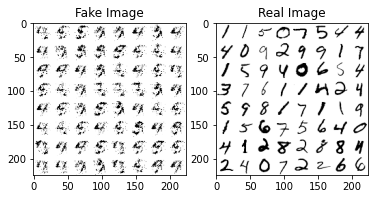

Epoch [14/100] \ Loss D: 0.0316, Recon Loss (MSE): 0.1081
Discriminator Accuracy = 99.41333333333333


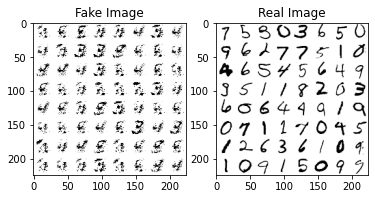

Epoch [15/100] \ Loss D: 0.0266, Recon Loss (MSE): 0.1128
Discriminator Accuracy = 99.50166666666667


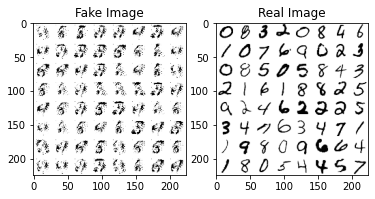

Epoch [16/100] \ Loss D: 0.0245, Recon Loss (MSE): 0.1094
Discriminator Accuracy = 99.52083333333334


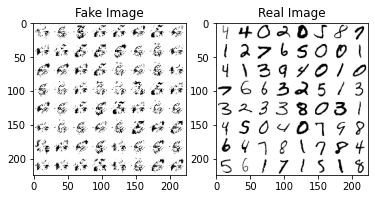

Epoch [17/100] \ Loss D: 0.0189, Recon Loss (MSE): 0.1184
Discriminator Accuracy = 99.595


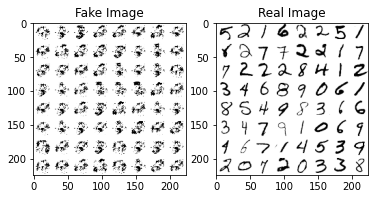

Epoch [18/100] \ Loss D: 0.0182, Recon Loss (MSE): 0.1167
Discriminator Accuracy = 99.62916666666666


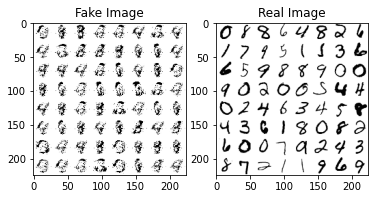

Epoch [19/100] \ Loss D: 0.0234, Recon Loss (MSE): 0.1060
Discriminator Accuracy = 99.53583333333333


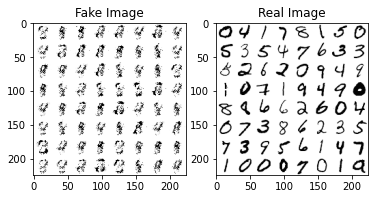

Epoch [20/100] \ Loss D: 0.0265, Recon Loss (MSE): 0.1013
Discriminator Accuracy = 99.49833333333333


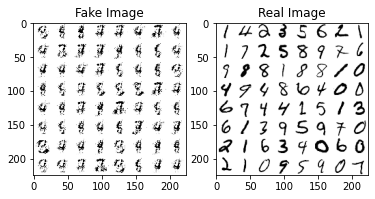

Epoch [21/100] \ Loss D: 0.0300, Recon Loss (MSE): 0.1011
Discriminator Accuracy = 99.35083333333333


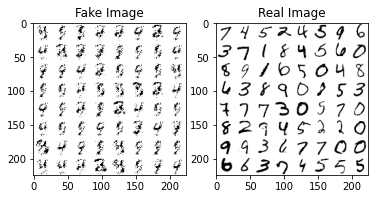

Epoch [22/100] \ Loss D: 0.0255, Recon Loss (MSE): 0.1043
Discriminator Accuracy = 99.47583333333333


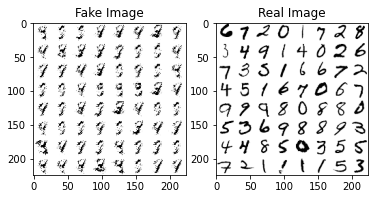

Epoch [23/100] \ Loss D: 0.0222, Recon Loss (MSE): 0.1037
Discriminator Accuracy = 99.59750000000001


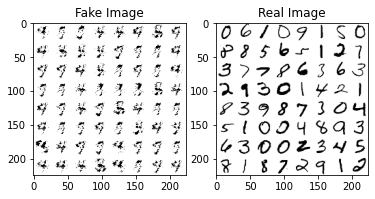

Epoch [24/100] \ Loss D: 0.0241, Recon Loss (MSE): 0.1086
Discriminator Accuracy = 99.46333333333334


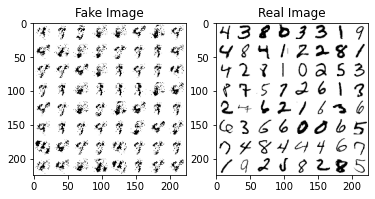

Epoch [25/100] \ Loss D: 0.0182, Recon Loss (MSE): 0.1098
Discriminator Accuracy = 99.60333333333334


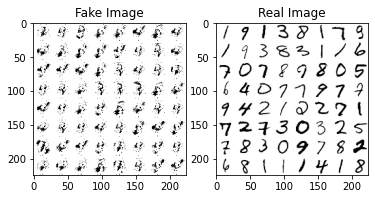

Epoch [26/100] \ Loss D: 0.0163, Recon Loss (MSE): 0.1075
Discriminator Accuracy = 99.67083333333333


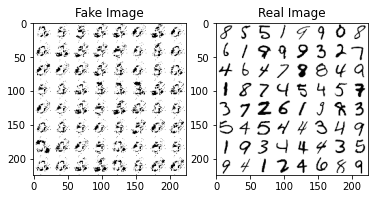

Epoch [27/100] \ Loss D: 0.0121, Recon Loss (MSE): 0.1158
Discriminator Accuracy = 99.7475


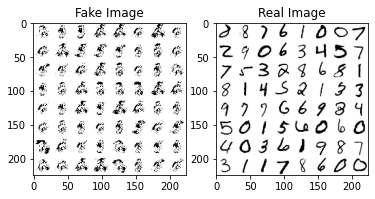

Epoch [28/100] \ Loss D: 0.0105, Recon Loss (MSE): 0.1131
Discriminator Accuracy = 99.7825


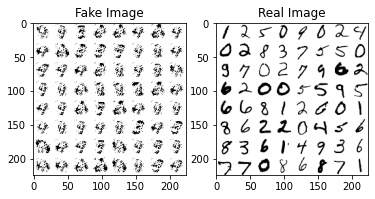

Epoch [29/100] \ Loss D: 0.0102, Recon Loss (MSE): 0.1112
Discriminator Accuracy = 99.8125


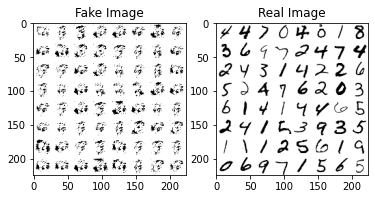

Epoch [30/100] \ Loss D: 0.0100, Recon Loss (MSE): 0.1109
Discriminator Accuracy = 99.80333333333333


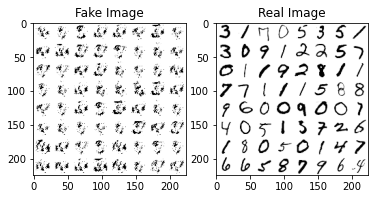

Epoch [31/100] \ Loss D: 0.0122, Recon Loss (MSE): 0.1083
Discriminator Accuracy = 99.7225


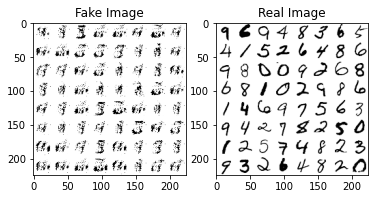

Epoch [32/100] \ Loss D: 0.0153, Recon Loss (MSE): 0.1049
Discriminator Accuracy = 99.65


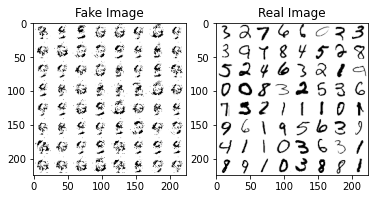

Epoch [33/100] \ Loss D: 0.0136, Recon Loss (MSE): 0.1067
Discriminator Accuracy = 99.70916666666668


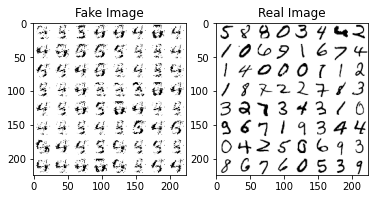

Epoch [34/100] \ Loss D: 0.0108, Recon Loss (MSE): 0.1133
Discriminator Accuracy = 99.74083333333333


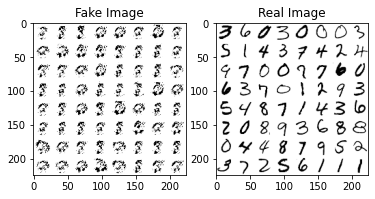

Epoch [35/100] \ Loss D: 0.0145, Recon Loss (MSE): 0.1039
Discriminator Accuracy = 99.65833333333333


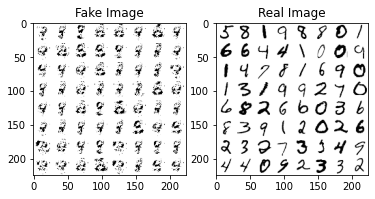

Epoch [36/100] \ Loss D: 0.0140, Recon Loss (MSE): 0.1023
Discriminator Accuracy = 99.70333333333333


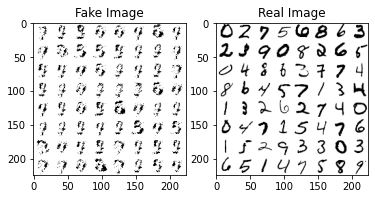

Epoch [37/100] \ Loss D: 0.0125, Recon Loss (MSE): 0.1062
Discriminator Accuracy = 99.73666666666666


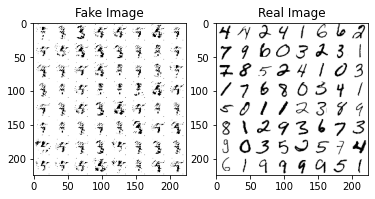

Epoch [38/100] \ Loss D: 0.0151, Recon Loss (MSE): 0.1046
Discriminator Accuracy = 99.65


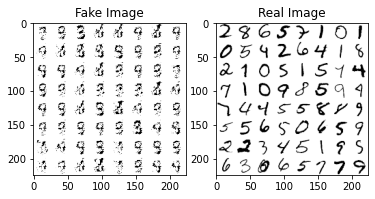

Epoch [39/100] \ Loss D: 0.0118, Recon Loss (MSE): 0.1067
Discriminator Accuracy = 99.73666666666666


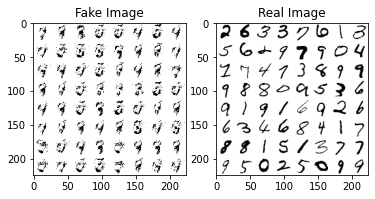

Epoch [40/100] \ Loss D: 0.0188, Recon Loss (MSE): 0.1057
Discriminator Accuracy = 99.54833333333333


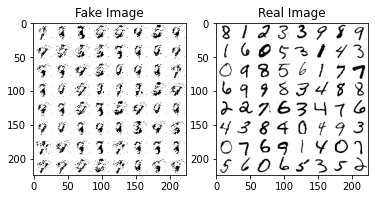

Epoch [41/100] \ Loss D: 0.0179, Recon Loss (MSE): 0.1065
Discriminator Accuracy = 99.55083333333333


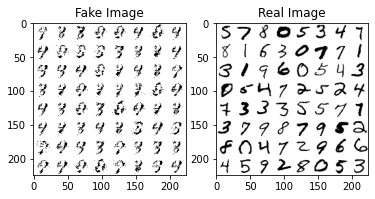

Epoch [42/100] \ Loss D: 0.0183, Recon Loss (MSE): 0.1033
Discriminator Accuracy = 99.5775


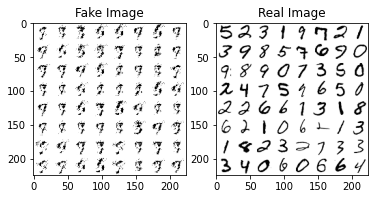

Epoch [43/100] \ Loss D: 0.0166, Recon Loss (MSE): 0.1035
Discriminator Accuracy = 99.60333333333334


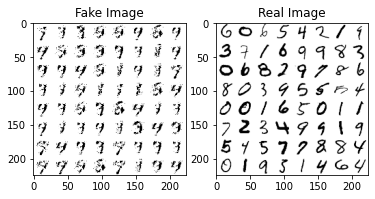

Epoch [44/100] \ Loss D: 0.0180, Recon Loss (MSE): 0.1053
Discriminator Accuracy = 99.55333333333334


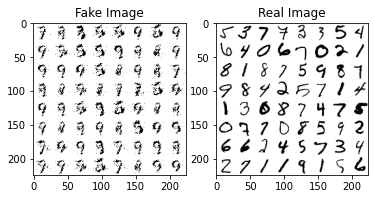

Epoch [45/100] \ Loss D: 0.0182, Recon Loss (MSE): 0.1044
Discriminator Accuracy = 99.53083333333333


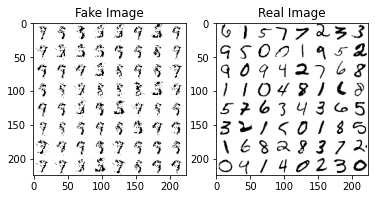

Epoch [46/100] \ Loss D: 0.0151, Recon Loss (MSE): 0.1068
Discriminator Accuracy = 99.63166666666666


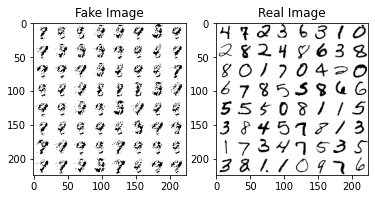

Epoch [47/100] \ Loss D: 0.0161, Recon Loss (MSE): 0.1047
Discriminator Accuracy = 99.62916666666666


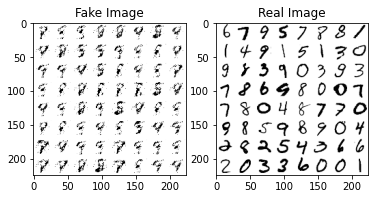

Epoch [48/100] \ Loss D: 0.0151, Recon Loss (MSE): 0.1071
Discriminator Accuracy = 99.65083333333334


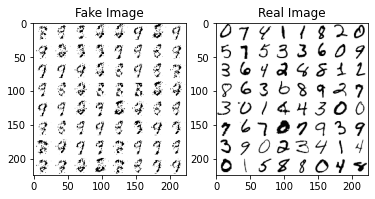

Epoch [49/100] \ Loss D: 0.0197, Recon Loss (MSE): 0.1042
Discriminator Accuracy = 99.52499999999999


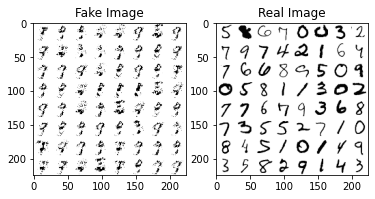

Epoch [50/100] \ Loss D: 0.0217, Recon Loss (MSE): 0.1016
Discriminator Accuracy = 99.47416666666666


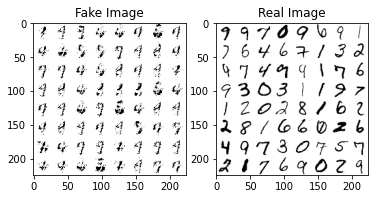

Epoch [51/100] \ Loss D: 0.0172, Recon Loss (MSE): 0.1015
Discriminator Accuracy = 99.58166666666666


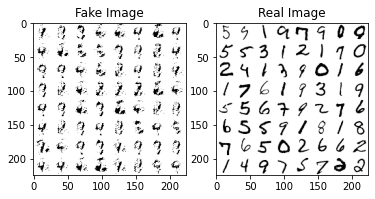

Epoch [52/100] \ Loss D: 0.0157, Recon Loss (MSE): 0.1041
Discriminator Accuracy = 99.62833333333333


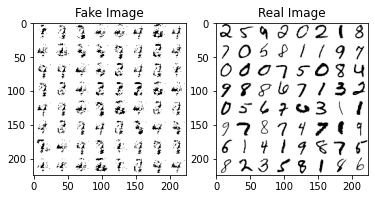

Epoch [53/100] \ Loss D: 0.0126, Recon Loss (MSE): 0.1077
Discriminator Accuracy = 99.6875


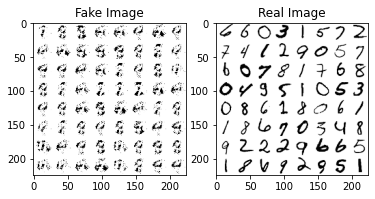

Epoch [54/100] \ Loss D: 0.0131, Recon Loss (MSE): 0.1102
Discriminator Accuracy = 99.6625


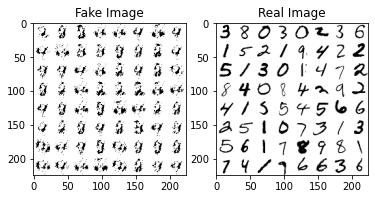

Epoch [55/100] \ Loss D: 0.0105, Recon Loss (MSE): 0.1138
Discriminator Accuracy = 99.72


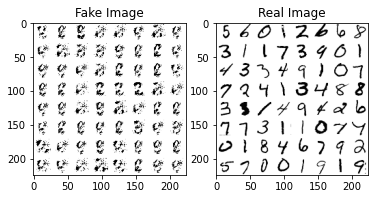

Epoch [56/100] \ Loss D: 0.0117, Recon Loss (MSE): 0.1085
Discriminator Accuracy = 99.72333333333333


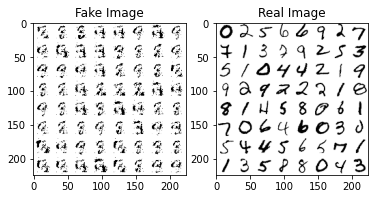

Epoch [57/100] \ Loss D: 0.0098, Recon Loss (MSE): 0.1125
Discriminator Accuracy = 99.74916666666667


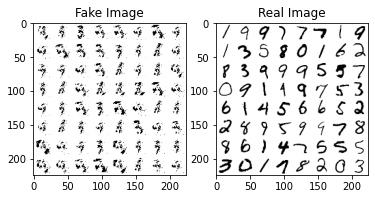

Epoch [58/100] \ Loss D: 0.0096, Recon Loss (MSE): 0.1103
Discriminator Accuracy = 99.75500000000001


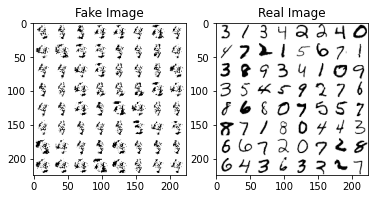

Epoch [59/100] \ Loss D: 0.0086, Recon Loss (MSE): 0.1127
Discriminator Accuracy = 99.785


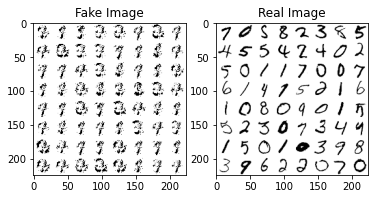

Epoch [60/100] \ Loss D: 0.0085, Recon Loss (MSE): 0.1086
Discriminator Accuracy = 99.79833333333333


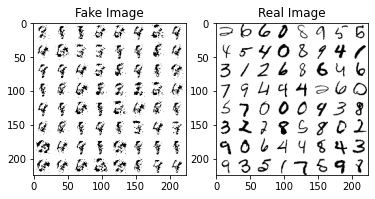

Epoch [61/100] \ Loss D: 0.0085, Recon Loss (MSE): 0.1114
Discriminator Accuracy = 99.80083333333334


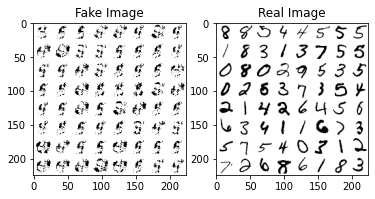

Epoch [62/100] \ Loss D: 0.0100, Recon Loss (MSE): 0.1127
Discriminator Accuracy = 99.76


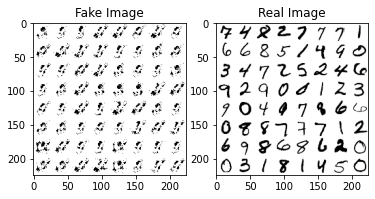

Epoch [63/100] \ Loss D: 0.0089, Recon Loss (MSE): 0.1131
Discriminator Accuracy = 99.79916666666668


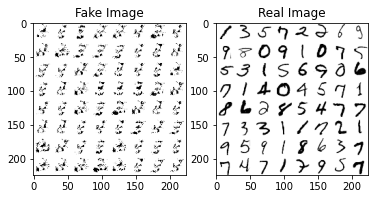

Epoch [64/100] \ Loss D: 0.0080, Recon Loss (MSE): 0.1081
Discriminator Accuracy = 99.81750000000001


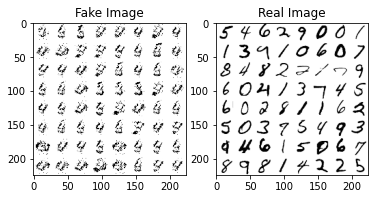

Epoch [65/100] \ Loss D: 0.0084, Recon Loss (MSE): 0.1122
Discriminator Accuracy = 99.79916666666668


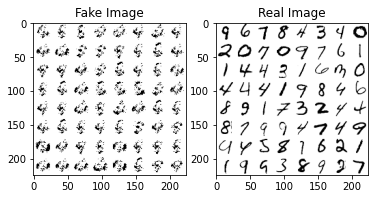

Epoch [66/100] \ Loss D: 0.0091, Recon Loss (MSE): 0.1118
Discriminator Accuracy = 99.77833333333334


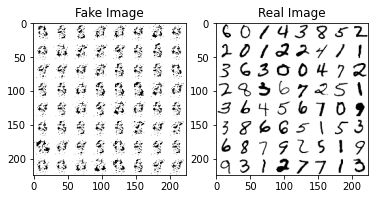

Epoch [67/100] \ Loss D: 0.0081, Recon Loss (MSE): 0.1110
Discriminator Accuracy = 99.80499999999999


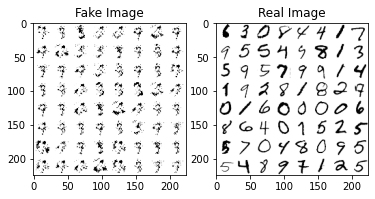

Epoch [68/100] \ Loss D: 0.0094, Recon Loss (MSE): 0.1058
Discriminator Accuracy = 99.78


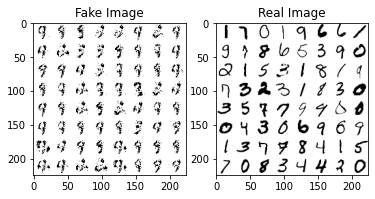

Epoch [69/100] \ Loss D: 0.0103, Recon Loss (MSE): 0.1089
Discriminator Accuracy = 99.74583333333334


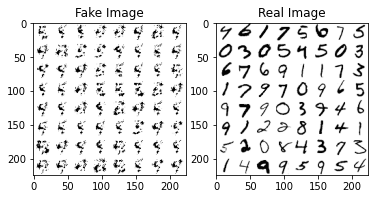

Epoch [70/100] \ Loss D: 0.0137, Recon Loss (MSE): 0.1044
Discriminator Accuracy = 99.665


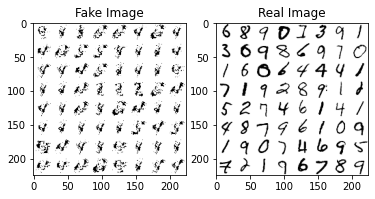

Epoch [71/100] \ Loss D: 0.0156, Recon Loss (MSE): 0.1038
Discriminator Accuracy = 99.63583333333334


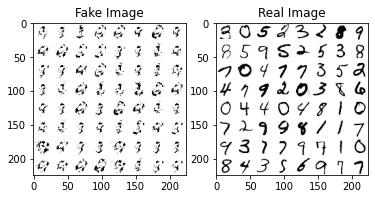

Epoch [72/100] \ Loss D: 0.0149, Recon Loss (MSE): 0.1042
Discriminator Accuracy = 99.61833333333333


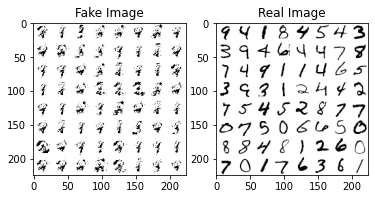

Epoch [73/100] \ Loss D: 0.0155, Recon Loss (MSE): 0.1051
Discriminator Accuracy = 99.62916666666666


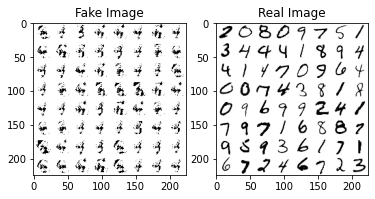

Epoch [74/100] \ Loss D: 0.0153, Recon Loss (MSE): 0.1044
Discriminator Accuracy = 99.63333333333333


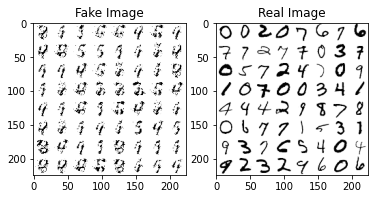

Epoch [75/100] \ Loss D: 0.0153, Recon Loss (MSE): 0.1039
Discriminator Accuracy = 99.62666666666667


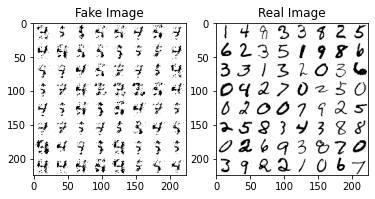

Epoch [76/100] \ Loss D: 0.0207, Recon Loss (MSE): 0.1054
Discriminator Accuracy = 99.46666666666667


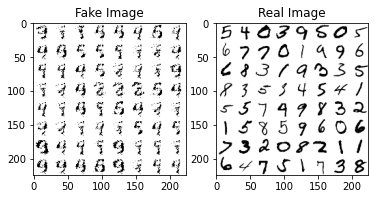

Epoch [77/100] \ Loss D: 0.0163, Recon Loss (MSE): 0.1022
Discriminator Accuracy = 99.58416666666666


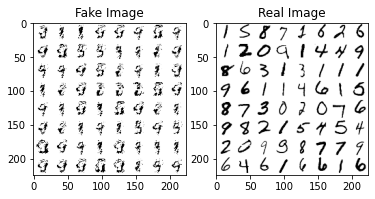

Epoch [78/100] \ Loss D: 0.0203, Recon Loss (MSE): 0.1017
Discriminator Accuracy = 99.49833333333333


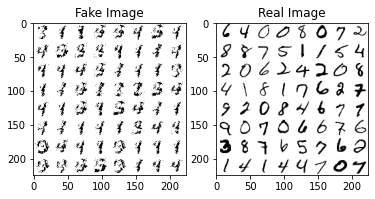

Epoch [79/100] \ Loss D: 0.0199, Recon Loss (MSE): 0.0998
Discriminator Accuracy = 99.49583333333332


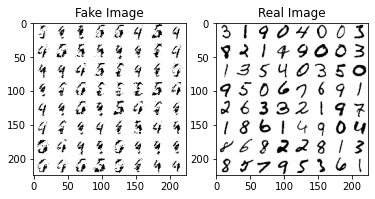

Epoch [80/100] \ Loss D: 0.0210, Recon Loss (MSE): 0.1032
Discriminator Accuracy = 99.50916666666667


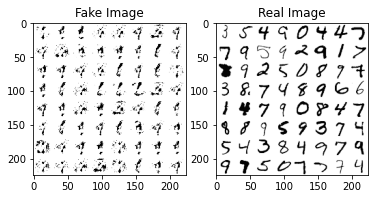

Epoch [81/100] \ Loss D: 0.0175, Recon Loss (MSE): 0.1090
Discriminator Accuracy = 99.58166666666666


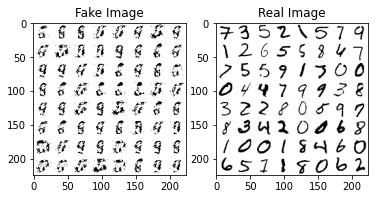

Epoch [82/100] \ Loss D: 0.0165, Recon Loss (MSE): 0.1087
Discriminator Accuracy = 99.57416666666667


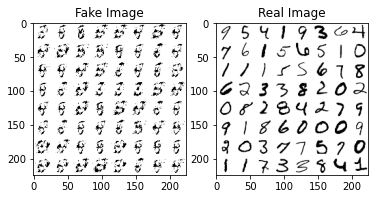

Epoch [83/100] \ Loss D: 0.0124, Recon Loss (MSE): 0.1092
Discriminator Accuracy = 99.68166666666667


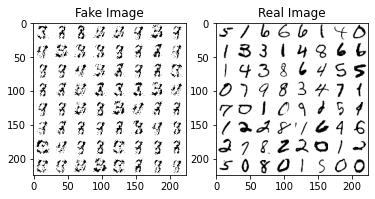

Epoch [84/100] \ Loss D: 0.0131, Recon Loss (MSE): 0.1114
Discriminator Accuracy = 99.68333333333334


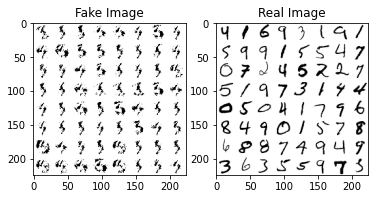

Epoch [85/100] \ Loss D: 0.0179, Recon Loss (MSE): 0.1042
Discriminator Accuracy = 99.555


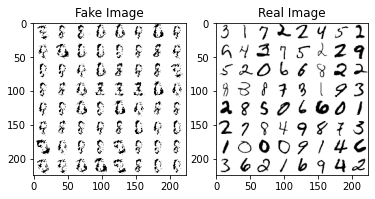

Epoch [86/100] \ Loss D: 0.0128, Recon Loss (MSE): 0.1092
Discriminator Accuracy = 99.68249999999999


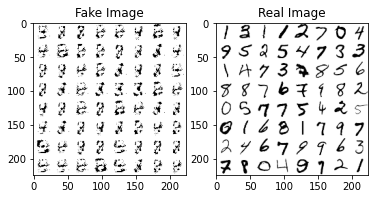

Epoch [87/100] \ Loss D: 0.0141, Recon Loss (MSE): 0.1029
Discriminator Accuracy = 99.65583333333333


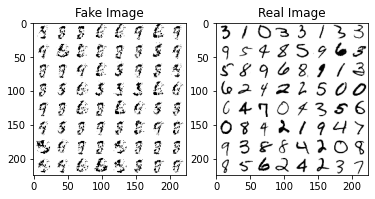

Epoch [88/100] \ Loss D: 0.0142, Recon Loss (MSE): 0.1048
Discriminator Accuracy = 99.64


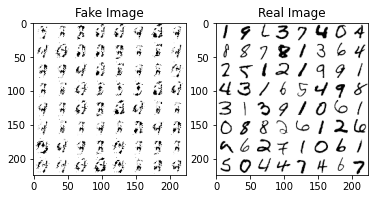

Epoch [89/100] \ Loss D: 0.0124, Recon Loss (MSE): 0.1041
Discriminator Accuracy = 99.69166666666666


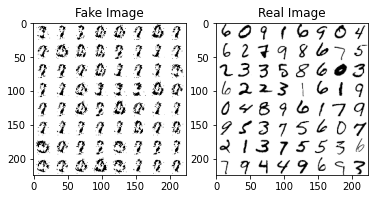

Epoch [90/100] \ Loss D: 0.0178, Recon Loss (MSE): 0.1033
Discriminator Accuracy = 99.55166666666668


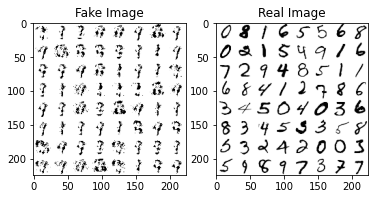

Epoch [91/100] \ Loss D: 0.0162, Recon Loss (MSE): 0.1009
Discriminator Accuracy = 99.63166666666666


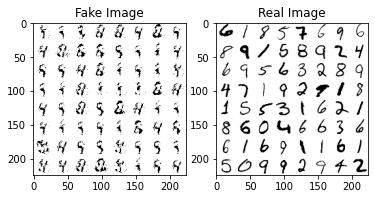

Epoch [92/100] \ Loss D: 0.0169, Recon Loss (MSE): 0.1036
Discriminator Accuracy = 99.56916666666666


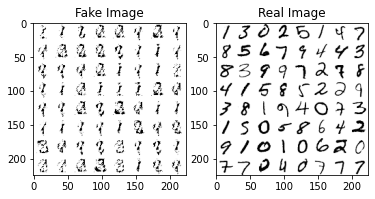

Epoch [93/100] \ Loss D: 0.0191, Recon Loss (MSE): 0.1005
Discriminator Accuracy = 99.55583333333334


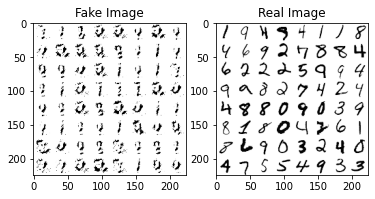

Epoch [94/100] \ Loss D: 0.0186, Recon Loss (MSE): 0.1008
Discriminator Accuracy = 99.5575


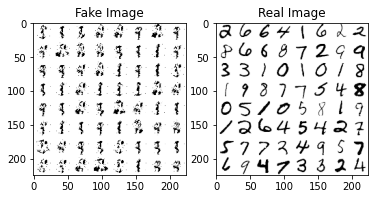

Epoch [95/100] \ Loss D: 0.0207, Recon Loss (MSE): 0.1010
Discriminator Accuracy = 99.49


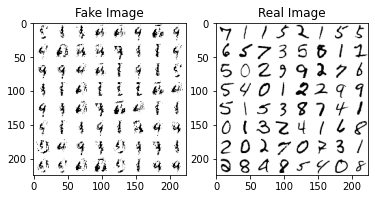

Epoch [96/100] \ Loss D: 0.0224, Recon Loss (MSE): 0.1021
Discriminator Accuracy = 99.46000000000001


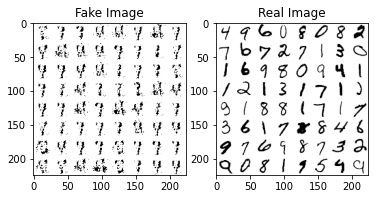

Epoch [97/100] \ Loss D: 0.0168, Recon Loss (MSE): 0.1040
Discriminator Accuracy = 99.57333333333334


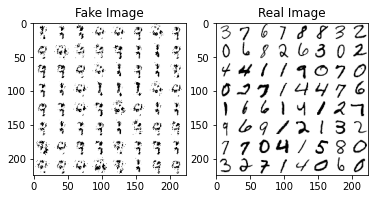

Epoch [98/100] \ Loss D: 0.0218, Recon Loss (MSE): 0.1039
Discriminator Accuracy = 99.45


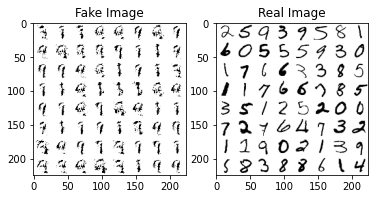

Epoch [99/100] \ Loss D: 0.0249, Recon Loss (MSE): 0.1020
Discriminator Accuracy = 99.385


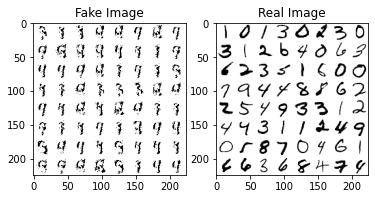

Epoch [100/100] \ Loss D: 0.0274, Recon Loss (MSE): 0.1006
Discriminator Accuracy = 99.29249999999999


In [9]:
disc_MSE = Dicriminator(image_dim).to(device)
en_MSE = Encoder(image_dim,z_dim).to(device)
dc_MSE = Decoder(z_dim,image_dim).to(device)

opt_disc_MSE = optim.Adam(disc_MSE.parameters(),lr=lr_disc)
opt_en_MSE = optim.Adam(en_MSE.parameters(),lr=lr_gen)
opt_dc_MSE = optim.Adam(dc_MSE.parameters(),lr=lr_gen)

criterion_mse = nn.MSELoss()
MSE_Loss_D = []
MSE_recon_loss = []
MSE_acc = []

for epoch in range(num_epochs):
    lossD_1= 0
    lossDec_1= 0
    lossEn_1 = 0
    Dis_acc = 0
    for batch_idx, (real,_) in enumerate(loader):
        
        real = real.view(-1,784).to(device)
        batch_size = real.shape[0]
        
        noise = torch.randn(batch_size,z_dim).to(device)
        fake = dc_MSE(noise)
        
        disc_real = disc_MSE(real).view(-1)
        disc_fake = disc_MSE(fake).view(-1)
        
        lossD_real = criterion(disc_real,torch.ones_like(disc_real))
        lossD_fake = criterion(disc_fake,torch.zeros_like(disc_fake))
        lossD = (lossD_real+lossD_fake)/2
        lossD_1+=lossD.item()
        
        D_pred_real = (((disc_real) >0.5)*1)
        D_pred_fake = (((disc_fake)>0.5)*1)
        Dis_acc += torch.sum((D_pred_real==torch.ones_like(disc_real))*1).item()
        Dis_acc += torch.sum((D_pred_fake==torch.zeros_like(disc_fake))*1).item()
        
        disc_MSE.zero_grad()
        lossD.backward(retain_graph=True)
        opt_disc_MSE.step()
        
        com = disc_MSE(fake).view(-1)
        lossDec= criterion(com,torch.ones_like(com))
        lossDec_1+=lossDec.item()
        dc_MSE.zero_grad()
        lossDec.backward()
        opt_dc_MSE.step()
        
        output = dc_MSE(en_MSE(real))
        lossEn = criterion_mse(output,real)
        lossEn_1+=lossEn.item()
        en_MSE.zero_grad()
        lossEn.backward()
        opt_en_MSE.step()
        
        if batch_idx ==0:
            with torch.no_grad():
                fake = dc_MSE(fixed_noise).reshape(-1,28,28)
                data = real.reshape(-1,28,28)
                img_grid_fake = image_grid(torchvision.utils.make_grid(fake,nrow=batch_size),8).to("cpu")#,normalize=True)
                img_grid_real = image_grid(torchvision.utils.make_grid(data,nrow=batch_size),8).to("cpu")#,normalize=True)
                plt.figure()
                plt.subplot(1,2,1)
                plt.imshow(img_grid_fake,cmap='Greys')
                plt.title("Fake Image")
                plt.subplot(1,2,2)
                plt.imshow(img_grid_real,cmap='Greys')
                plt.title("Real Image")
                plt.show()
                time.sleep(0.01)
        
    lossD_1/=(batch_idx+1)
    loss_g = (lossEn_1)/(batch_idx+1)
    Dis_acc /= 120000
    print(
        f"Epoch [{epoch+1}/{num_epochs}] \ "
        f"Loss D: {lossD_1:.4f}, Recon Loss (MSE): {loss_g:.4f}")
    print(f"Discriminator Accuracy = {Dis_acc*100}")
    MSE_Loss_D.append(lossD_1)
    MSE_recon_loss.append(loss_g)
    MSE_acc.append(Dis_acc*100)

C:\Users\ADMIN\AppData\Local\Temp\ipykernel_15980\1281392723.py:4: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r-" (-> color='r'). The keyword argument will take precedence.
  plt.plot(range(num_epochs),SSIM_Loss_D,'r-',color='blue',label='Model-SSIM Loss')
C:\Users\ADMIN\AppData\Local\Temp\ipykernel_15980\1281392723.py:5: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r-" (-> color='r'). The keyword argument will take precedence.
  plt.plot(range(num_epochs),MSE_Loss_D,'r-',color='green',label='Model-MSE Loss')
C:\Users\ADMIN\AppData\Local\Temp\ipykernel_15980\1281392723.py:13: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "r-" (-> color='r'). The keyword argument will take precedence.
  plt.plot(range(num_epochs),SSIM_recon_loss,'r-',color='blue',label='Model-SSIM Loss')
C:\Users\ADMIN\AppData\Local\Temp\ipykernel_15980\1281392723.py:14: User

Text(0.5, 1.0, 'Training Accuracy (Discriminator)')

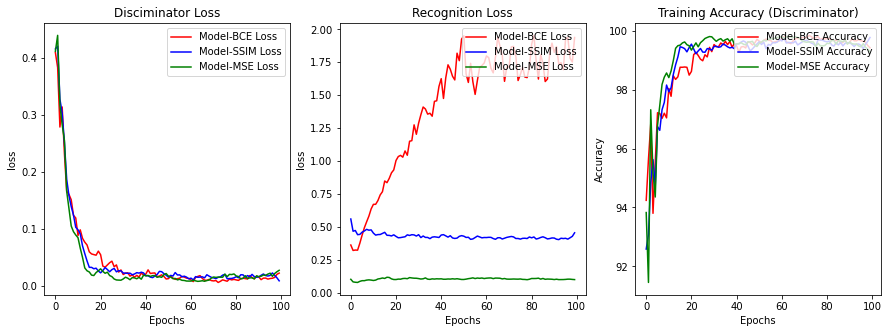

In [10]:
fig = plt.figure(figsize=[15,5]) 
plt.subplot(1,3,1)
plt.plot(range(num_epochs),BCE_Loss_D,'r-',label='Model-BCE Loss') 
plt.plot(range(num_epochs),SSIM_Loss_D,'r-',color='blue',label='Model-SSIM Loss')
plt.plot(range(num_epochs),MSE_Loss_D,'r-',color='green',label='Model-MSE Loss')
plt.legend(loc='upper right')
plt.xlabel('Epochs')
plt.ylabel('loss')
plt.title("Disciminator Loss")

plt.subplot(1,3,2)
plt.plot(range(num_epochs),BCE_recon_loss,'r-',label='Model-BCE Loss') 
plt.plot(range(num_epochs),SSIM_recon_loss,'r-',color='blue',label='Model-SSIM Loss')
plt.plot(range(num_epochs),MSE_recon_loss,'r-',color='green',label='Model-MSE Loss')
plt.legend(loc='upper right')
plt.xlabel('Epochs')
plt.ylabel('loss')
plt.title("Recognition Loss")

plt.subplot(1,3,3)
plt.plot(range(num_epochs),BCE_acc,'r-',label='Model-BCE Accuracy') 
plt.plot(range(num_epochs),SSIM_acc,'r-',color='blue',label='Model-SSIM Accuracy')
plt.plot(range(num_epochs),MSE_acc,'r-',color='green',label='Model-MSE Accuracy')
plt.legend(loc='upper right')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.title("Training Accuracy (Discriminator)")